In [52]:
import datetime as dt
from dateutil.relativedelta import relativedelta
import yfinance as yf  
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from pandas.tseries.holiday import USFederalHolidayCalendar
import datetime
import holidays
from statsmodels.tsa.stattools import adfuller
from dtaidistance import preprocessing
from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler
from datetime import date
from dateutil.relativedelta import *
from sklearn_extra.cluster import KMedoids
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from tslearn.clustering import TimeSeriesKMeans, silhouette_score
from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score
from tslearn.utils import to_time_series_dataset
from tslearn.metrics import cdist_dtw, dtw as ts_dtw
from tslearn.barycenters import dtw_barycenter_averaging
from plotly.subplots import make_subplots

In [2]:
end = pd.to_datetime('2024-01-21')
start = pd.to_datetime('2024-01-21') - relativedelta(weeks=103)

years = [end.year-i for i in range(end.year-start.year + 1)]
nyse_holidays = holidays.NYSE(years=years)

### Import Data from CSV

In [3]:
data = pd.read_csv('SP500_Hourly_102Weeks_2024_01_14.csv', index_col=0, parse_dates=True)  
data.index = pd.to_datetime(data.index, utc=True).tz_convert('America/New_York')

In [4]:
data.head(10)

,Open,High,Low,Close,Adj Close,Volume
Datetime,,,,,,
2022-01-31 09:30:00-05:00,4431.790039,4472.020020,4414.020020,4458.209961,4458.209961,0
2022-01-31 10:30:00-05:00,4458.339844,4468.830078,4452.740234,4455.779785,4455.779785,310320785
2022-01-31 11:30:00-05:00,4456.299805,4483.180176,4453.419922,4477.540039,4477.540039,259708983
2022-01-31 12:30:00-05:00,4477.490234,4489.350098,4473.399902,4482.819824,4482.819824,237902000
2022-01-31 13:30:00-05:00,4482.890137,4497.709961,4479.939941,4497.709961,4497.709961,218623000
2022-01-31 14:30:00-05:00,4497.750000,4497.930176,4471.459961,4486.180176,4486.180176,291230000
2022-01-31 15:30:00-05:00,4486.189941,4516.890137,4482.020020,4515.439941,4515.439941,464471000
2022-02-01 09:30:00-05:00,4519.569824,4525.560059,4483.529785,4501.950195,4501.950195,0
2022-02-01 10:30:00-05:00,4501.970215,4522.270020,4493.779785,4512.879883,4512.879883,349426580


In [7]:
df = pd.DataFrame(data.Close)
display(df)

,Close
Datetime,
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2024-01-19 11:30:00-05:00,4809.129883
2024-01-19 12:30:00-05:00,4825.220215
2024-01-19 13:30:00-05:00,4835.379883


#### Differencing the data for additional analysis

In [8]:
def adfuller_test(df):
    result=adfuller(df)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )

    if result[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary")
    else:
        print("weak evidence against null hypothesis, indicating it is non-stationary ")


In [9]:
df_time_series = df.Close.ravel()
print(adfuller_test(df_time_series))

df_differenced_time_series = preprocessing.differencing(np.log(df_time_series), smooth=0.1)
print(adfuller_test(df_differenced_time_series))


ADF Test Statistic : -1.4856727798675178
p-value : 0.5405865300206391
#Lags Used : 9
Number of Observations : 3443
weak evidence against null hypothesis, indicating it is non-stationary 
None
ADF Test Statistic : -8.822619260286148
p-value : 1.859623627196573e-14
#Lags Used : 30
Number of Observations : 3421
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
None


In [10]:
df_differenced = pd.DataFrame(df_differenced_time_series, index=df.index[1:], columns=['Close'])

In [11]:
df_differenced

,Close
Datetime,
2022-01-31 10:30:00-05:00,-0.000544
2022-01-31 11:30:00-05:00,0.000559
2022-01-31 12:30:00-05:00,0.001310
2022-01-31 13:30:00-05:00,0.001618
2022-01-31 14:30:00-05:00,0.001603
...,...
2024-01-19 11:30:00-05:00,0.002052
2024-01-19 12:30:00-05:00,0.001880
2024-01-19 13:30:00-05:00,0.001525


### Visualize weekly price data 

In [12]:
def plot_time_series(df):
    df = df.reset_index()
    fig = go.Figure()

    # fig = px.line(df, x='Datetime', y="Close")
    fig.add_trace(go.Scatter(y=df.Close, x=df.Datetime, mode="lines"))

    fig.update_layout(
        plot_bgcolor='white'
    )

    fig.update_xaxes(
            mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey',
        rangebreaks=[
    #         dict(values=list(nyse_holidays.keys())),  # hide NYSE holidays
            dict(values=[x for x in list(nyse_holidays.keys()) if x.weekday() != 4]),
            dict(bounds=["sat", "mon"]), #hide weekends
            dict(bounds=[16, 9.5], pattern="hour"), #hide hours outside of 9am-5pm
        ]
    )

    fig.update_yaxes(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey'
    )

    fig.show()

In [15]:
plot_time_series(df)

In [16]:
def plot_time_series_by_week(df):
    
    grp_df = df.groupby(pd.Grouper(freq='W'))
    df = df.reset_index()

    fig = go.Figure()
    # Add background line plot
    fig.add_trace(go.Scatter(y=df.Close, x=df.Datetime, mode="lines", line_color='lightgrey', showlegend=False))

    for key, item in grp_df:
        item.reset_index(inplace=True)
        fig.add_trace(go.Scatter(y=item.Close, x=item.Datetime, mode="lines", name=key.strftime('%Y-%m-%d')))

    fig.update_layout(
        plot_bgcolor='white'
    )

    fig.update_xaxes(
            mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey',
        range=[start, end],
        rangebreaks=[
            dict(values=[x for x in list(nyse_holidays.keys()) if x.weekday() != 4]),  # hide NYSE holidays excluding those that fall on a Friday. 
            # Plotly rangebreaks bug makes them overlap
            dict(bounds=["sat", "mon"]), #hide weekends
            dict(bounds=[16, 9.5], pattern="hour"), #hide hours outside of 9am-5pm
        ],
    #      ticklabelmode= "period", 
    #      tickcolor= "black", 
    #      ticklen=10, 
    #      minor=dict(
    #          ticklen=4,  
    #          ticks='inside',
    #          dtick=7*24*60*60*1000,  
    #          griddash='dot', 
    #          gridcolor='grey')
    )

    fig.update_yaxes(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey'
    )

    fig.show()

In [17]:
plot_time_series_by_week(df)

#### Differenced Time Series

In [18]:
plot_time_series(df_differenced)

In [19]:
plot_time_series_by_week(df_differenced)

#### Apply Normalization to the dataset

In [22]:
def plot_normalized_data(df):
    grp_df = df.groupby(pd.Grouper(freq='W'))
    timeseries_combined_np = []

    min_length = float('inf')
    num_of_weeks = len(grp_df)

    for key, item in grp_df:
        series = item.Close.to_numpy()
        min_length = min(min_length, series.shape[0])
        timeseries_combined_np.append(series)

    print(f"Min Length for time series: {min_length}")
    Resampler = TimeSeriesResampler(sz=min_length)
    timeseries_combined_np_resampled = Resampler.fit_transform(timeseries_combined_np)

    Scaler = TimeSeriesScalerMeanVariance()
    timeseries_normalized = Scaler.fit_transform(timeseries_combined_np_resampled)

    #plot
    plt.figure(figsize=(5, num_of_weeks))
    for i in range(num_of_weeks):
        # Plot non-normalized
        plt.subplot(num_of_weeks, 2, 2*i+1)
        plt.plot(timeseries_combined_np_resampled[i].ravel(), "k-")
        plt.xlim(0, min_length)
        if i == 0:
            plt.title("Non-Normalized")

        # Plot normalized
        plt.subplot(num_of_weeks, 2, 2*i+2)
        plt.plot(timeseries_normalized[i].ravel(), "b-")
        plt.xlim(0, min_length)
        plt.ylim(-4, 4)
        if i == 0:
            plt.title("Normalized")


    plt.tight_layout()
    plt.show()

Min Length for time series: 24


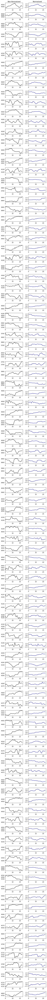

In [23]:
plot_normalized_data(df)

In [24]:
def process_data(df):
    grp_df = df.groupby(pd.Grouper(freq='W'))
    num_of_weeks = len(grp_df)
    
    timeseries_combined = []

    min_length = float('inf')

    for key, item in grp_df:
        series = item.Close.to_numpy()
        min_length = min(min_length, series.shape[0])
        timeseries_combined.append(series)

    return timeseries_combined, min_length
    
def resample_data(df, length):
    Resampler = TimeSeriesResampler(sz=length)
    return Resampler.fit_transform(df)

def rescale_data(df):
    # Default mean = 0, std = 1
    Scaler = TimeSeriesScalerMeanVariance()
    return Scaler.fit_transform(df)

### Train-Test Split

In [25]:
class TimeBasedCV(object):
    '''
    Parameters 
    ----------
    train_period: int
        number of time units to include in each train set
        default is 30
    test_period: int
        number of time units to include in each test set
        default is 7
    freq: string
        frequency of input parameters. possible values are: days, months, years, weeks, hours, minutes, seconds
        possible values designed to be used by dateutil.relativedelta class
        deafault is days
    '''
    
    
    def __init__(self, train_period=30, test_period=7, freq='days'):
        self.train_period = train_period
        self.test_period = test_period
        self.freq = freq

        
        
    def split(self, data, validation_split_date=None, date_column='record_date', gap=0):
        '''
        Generate indices to split data into training and test set
        
        Parameters 
        ----------
        data: pandas DataFrame
            your data, contain one column for the record date 
        validation_split_date: datetime.date()
            first date to perform the splitting on.
            if not provided will set to be the minimum date in the data after the first training set
        date_column: string, deafult='record_date'
            date of each record
        gap: int, default=0
            for cases the test set does not come right after the train set,
            *gap* days are left between train and test sets
        
        Returns 
        -------
        train_index ,test_index: 
            list of tuples (train index, test index) similar to sklearn model selection
        '''
        
        # check that date_column exist in the data:
        try:
            data[date_column]
        except:
            raise KeyError(date_column)
                    
        train_indices_list = []
        test_indices_list = []

        if validation_split_date==None:
            validation_split_date = data[date_column].min().date() + eval('relativedelta('+self.freq+'=self.train_period)')
        
        start_train = validation_split_date - eval('relativedelta('+self.freq+'=self.train_period)')
        end_train = start_train + eval('relativedelta('+self.freq+'=self.train_period)')
        start_test = end_train + eval('relativedelta('+self.freq+'=gap)')
        end_test = start_test + eval('relativedelta('+self.freq+'=self.test_period)')

        while end_test < data[date_column].max().date():
            # train indices:
            cur_train_indices = list(data[(data[date_column].dt.date>=start_train) & 
                                     (data[date_column].dt.date<end_train)].index)

            # test indices:
            cur_test_indices = list(data[(data[date_column].dt.date>=start_test) &
                                    (data[date_column].dt.date<end_test)].index)
            
            print("Train period:",start_train,"-" , end_train, ", Test period", start_test, "-", end_test,
                  "# train records", len(cur_train_indices), ", # test records", len(cur_test_indices))

            train_indices_list.append(cur_train_indices)
            test_indices_list.append(cur_test_indices)

            # update dates:
            start_train = start_train + eval('relativedelta('+self.freq+'=self.test_period)')
            end_train = start_train + eval('relativedelta('+self.freq+'=self.train_period)')
            start_test = end_train + eval('relativedelta('+self.freq+'=gap)')
            end_test = start_test + eval('relativedelta('+self.freq+'=self.test_period)')

        # mimic sklearn output  
        index_output = [(train,test) for train,test in zip(train_indices_list,test_indices_list)]

        self.n_splits = len(index_output)
        
        return index_output
    
    
    def get_n_splits(self):
        """Returns the number of splitting iterations in the cross-validator
        Returns
        -------
        n_splits : int
            Returns the number of splitting iterations in the cross-validator.
        """
        return self.n_splits 

In [26]:
tscv = TimeBasedCV(train_period=78,
                   test_period=6,
                   freq='weeks')
for train_index, test_index in tscv.split(df.reset_index(),
#                    validation_split_date=datetime.date(2019,2,1),
                                          date_column='Datetime'):
    print(f"train_index: {train_index}")
    print(f"test_index: {test_index}")

# get number of splits
tscv.get_n_splits()

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2617 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196
train_index: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124,

4

#### Visualizing the train-test periods

In [27]:
def plot_train_test_splits(df):
    df = df.reset_index()
    fig = go.Figure()

    idx = 1
    for train_index, test_index in tscv.split(df, date_column='Datetime'):
    #     print(train_index, test_index)
        X_train_df = df.loc[train_index]
        fig.add_trace(go.Scatter(y=X_train_df.Close, x=X_train_df.Datetime, mode="lines", name= f'X_Train_{idx}'))

        X_test_df = df.loc[test_index]
        fig.add_trace(go.Scatter(y=X_test_df.Close, x=X_test_df.Datetime, mode="lines", name=f'X_Test_{idx}'))

        idx += 1

    fig.update_layout(
    plot_bgcolor='white'
    )

    fig.update_xaxes(
            mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey',
        range=[start, end],
        rangebreaks=[
            dict(values=[x for x in list(nyse_holidays.keys()) if x.weekday() != 4]),  # hide NYSE holidays excluding those that fall on a Friday. 
            # Plotly rangebreaks bug makes them overlap
            dict(bounds=["sat", "mon"]), #hide weekends
            dict(bounds=[16, 9.5], pattern="hour"), #hide hours outside of 9am-5pm
        ],
    )

    fig.update_yaxes(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey'
    )

    # Enable autoscale for x-axis
    fig['layout']['xaxis'].update(autorange = True)

    fig.show()

In [28]:
plot_train_test_splits(df)

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2617 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196


#### Differenced Dataset

In [29]:
plot_train_test_splits(df_differenced)

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2616 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196


#### DTW K-Means Clustering Helper Functions

In [30]:
def select_optimal_k(results, choice, n_classes):
    results_list = results[choice]
    if choice == "wcss":
        wss = np.array(results_list) 
        k_range = range(2, n_classes + 1)
        slope = (wss[0] - wss[-1]) / (k_range[0] - k_range[-1])
        intercept = wss[0] - slope * k_range[0]
        y = k_range * slope + intercept
        optimal_k = k_range[(y - wss).argmax()]
    else:
        optimal_k_index = results_list.index(max(results_list))
        optimal_k = optimal_k_index + 2
    
    return optimal_k

# Wrapper for sklearn.metrics functions
def compute_sklearn_metrics(X, labels, scoring, metric=None, labels_true=None, km=None, X_train=None):
    if X.size == 0 or labels.size == 0 or not scoring:
        print('Missing Parameters')
        return
    
    # Transform X for sklearn 
    X_ = to_time_series_dataset(X)
    X_ = X_.reshape((X.shape[0],-1))
    
    if scoring == 'silhouette':
        if metric == 'dtw':
            return silhouette_score(cdist_dtw(X_), labels, metric='precomputed')
        elif metric == 'softdtw':
            # Add gamma parameter if necessary
            return silhouette_score(cdist_soft_dtw_normalized(X_, gamma=0.01), labels, metric='precomputed')
        else:
            return silhouette_score(X_, labels)
    else:
        if scoring == 'calinski_harabasz':
            return calinski_harabasz_score(X_, labels)
        elif scoring == 'calinski_harabasz_dtw':
            return calinski_harabasz_score_dtw(X_, labels, km)
        elif scoring == 'davies_bouldin':
            return davies_bouldin_score(X_, labels)
        elif scoring == 'davies_bouldin_dtw':
            return davies_bouldin_score_dtw(X_, labels, km)
        elif scoring == 'davies_bouldin_medoids':
            return davies_bouldin_score_medoids(X_, labels, km, X_train)
        elif scoring == 'davies_bouldin_medoids_dtw':
            return davies_bouldin_score_medoids(X_, labels, km, X_train, dtw=True)   
        elif scoring == 'v_measure_score':
            return v_measure_score(labels_true, labels)
        
def davies_bouldin_score_dtw(X, labels, km):
    n_labels = len(np.unique(labels))
    n_samples, _ = X.shape
    
    intra_dists = np.zeros(n_labels)
    centroids = np.zeros((n_labels, len(X[0])), dtype=float)
    for k in range(n_labels):
        cluster_k = X[labels == k]
        #Skip if cluster has no predictions
        if cluster_k.size == 0:
            continue
        # Use DBA cluster centroid
        centroid = np.transpose(km.cluster_centers_[k])
        centroids[k] = centroid
        # Use DTW distance to calculate distances from cluster objects to centroid
        intra_dists[k] = np.average(cdist_dtw(cluster_k, centroid))
#         intra_dists[k] = np.average(pairwise_distances(cluster_k, centroid))

    # Use DTW distance to calculate distance between centroids
    centroid_distances = cdist_dtw(centroids)
#     centroid_distances = pairwise_distances(centroids)

    if np.allclose(intra_dists, 0) or np.allclose(centroid_distances, 0):
        return 0.0

    centroid_distances[centroid_distances == 0] = np.inf
    combined_intra_dists = intra_dists[:, None] + intra_dists
    scores = np.max(combined_intra_dists / centroid_distances, axis=1)
    return np.mean(scores)

def davies_bouldin_score_medoids(X, labels, km, X_train=None, dtw=None):
    n_labels = len(np.unique(labels))
    n_samples, _ = X.shape
    
    intra_dists = np.zeros(n_labels)
    centroids = np.zeros((n_labels, len(X[0])), dtype=float)
    for k in range(n_labels):
        cluster_k = X[labels == k]
        #Skip if cluster has no predictions
        if cluster_k.size == 0:
            continue
        # Use DBA cluster centroid
        if X_train is None:
            centroid = np.transpose(X[km.medoid_indices_[k]])
        else:
            centroid = np.transpose(X_train[km.medoid_indices_[k]])

        centroids[k] = centroid
        # Use DTW distance to calculate distances from cluster objects to centroid
        if dtw:
            intra_dists[k] = np.average(cdist_dtw(cluster_k, centroid))
        else:
            if X_train is None:
                intra_dists[k] = np.average(pairwise_distances(cluster_k, [centroid]))
            else:
                intra_dists[k] = np.average(pairwise_distances(cluster_k, centroid))
 
    # Use DTW distance to calculate distance between centroids
    if dtw:
        centroid_distances = cdist_dtw(centroids)
    else:
        centroid_distances = pairwise_distances(centroids)

    if np.allclose(intra_dists, 0) or np.allclose(centroid_distances, 0):
        return 0.0

    centroid_distances[centroid_distances == 0] = np.inf
    combined_intra_dists = intra_dists[:, None] + intra_dists
    scores = np.max(combined_intra_dists / centroid_distances, axis=1)
    return np.mean(scores)

def plot_helper(barycenter, X):
    # plot all points of the data set
    for series in X:
        plt.plot(series.ravel(), "k-", alpha=.2)
    # plot the given barycenter of them
    plt.plot(barycenter.ravel(), "r-", linewidth=2)
    plt.tight_layout()
    plt.show()

def calinski_harabasz_score_dtw(X, labels, km):
    
    n_labels = len(np.unique(labels))
    n_samples, _ = X.shape
    
    extra_disp, intra_disp = 0.0, 0.0
    # Global DBA Average
    dba_global_mean = np.transpose(dtw_barycenter_averaging(X, max_iter=10, n_init=2))
#     plot_helper(dtw_barycenter_averaging(X, max_iter=10, n_init=2), X)

    
#     mean = np.mean(X, axis=0)
    for k in range(n_labels):
        cluster_k = X[labels == k]
        #Skip if cluster has no predictions
        if cluster_k.size == 0:
            continue
        
        # Find the cluster DBA average
        dba_cluster_k_mean = np.transpose(km.cluster_centers_[k])
        #         mean_k = np.mean(cluster_k, axis=0)
        
        # Use DTW distance instead of squared Euclidean distance
        extra_disp += len(cluster_k) * (ts_dtw(dba_cluster_k_mean, dba_global_mean) ** 2)
#         extra_disp += len(cluster_k) * np.sum((dba_cluster_k_mean - dba_global_mean) ** 2)
#         extra_disp += len(cluster_k) * np.sum((mean_k - mean) ** 2)
        intra_disp += ts_dtw(cluster_k, dba_cluster_k_mean) ** 2
#         intra_disp += np.sum((cluster_k - dba_cluster_k_mean) ** 2)
#         intra_disp += np.sum((cluster_k - mean_k) ** 2)

    return (
        1.0
        if intra_disp == 0.0
        else extra_disp * (n_samples - n_labels) / (intra_disp * (n_labels - 1.0))
    )

### Analysis using DBA Methods

In [32]:
def dba_k_means_clustering(X_train, X_test):
    # DBA-k-means
    print("\nDBA k-means\n")
    print(f"X_train shape: {X_train.shape}")
    print(f"X_test shape: {X_test.shape}")

    #Metrics
    validation_indexes = ['wcss', 'silhouette', 'calinski_harabasz', 'calinski_harabasz_dtw', 'davies_bouldin', 'davies_bouldin_dtw']
    choice = 'wcss'
    results = {vi: [] for vi in validation_indexes}
    n_classes = 6
    seed = 0
    sz = X_train.shape[1]

    # Finding optimal k clusters
    df_indexes = []
    predictions = []
    models = []

    for i in range(2, n_classes + 1):
        df_indexes.append(f"k={i}")
        dba_km = TimeSeriesKMeans(n_clusters=i,
                                  n_init=2,
                                  metric="dtw",
    #                               metric_params={"global_constraint": "sakoe_chiba"},
    #                               verbose=True,
                                  dtw_inertia=True,
                                  max_iter_barycenter=10,
                                  random_state=seed)
        y_pred_train = dba_km.fit_predict(X_train)
        # Store model and predictions
        models.append(dba_km)
        predictions.append(y_pred_train)

        for index in validation_indexes:
            if index == 'wcss':
                results[index].append(dba_km.inertia_)
            else:
                results[index].append(compute_sklearn_metrics(X_train, y_pred_train, scoring=index, metric='dtw', km=dba_km))

    results_df = pd.DataFrame(results, index = df_indexes)
    display(results_df)

    # Plot Elbow method
    plt.figure(1)
    plt.title("Elbow Plot for DBA K-Means")
    plt.ylabel("WCSS")
    plt.plot(df_indexes, results['wcss'], marker = 'o')
    plt.show()

    #Evaluate value of k based on choice
    print(f"Finding optimal k based on {choice}")

    # CHANGE THIS ONCE THE OPTIMAL K IS DECIDED
#     optimal_k = select_optimal_k(results, choice, n_classes)
    optimal_k = 4
    print(f"Optimal k is found to be {optimal_k}")

    # Retrieve optimal model
    dba_km = models[optimal_k - 2]
    y_pred_train = predictions[optimal_k - 2]
    y_pred_test = dba_km.predict(X_test)

    #Metrics
    print("Testing Results")
    test_validation_index = ['wcss', 'silhouette', 'calinski_harabasz_dtw', 'davies_bouldin_dtw']
    test_results = {vi: [] for vi in test_validation_index}

    for index in test_validation_index:
        if index == 'wcss':
            test_results[index].append(dba_km.inertia_)
        else:
            test_results[index].append(compute_sklearn_metrics(X_test, y_pred_test, scoring=index, metric='dtw', km=dba_km))

    test_results_df = pd.DataFrame(test_results, index=[f"k={optimal_k}"])
    display(test_results_df)

    #Plotting
    subplot_index = 1
    plt.figure(figsize=(12, 9))

    for yi in range(optimal_k):
        plt.subplot(2, optimal_k, subplot_index + yi)
        for xx in X_train[y_pred_train == yi]:
            plt.plot(xx.ravel(), "k-", alpha=.2)
        plt.plot(dba_km.cluster_centers_[yi].ravel(), "r-")
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85,'Cluster %d' % (yi + 1),
                 transform=plt.gca().transAxes)
        if yi == optimal_k//2:
            plt.title("DBA $k$-means (Training)")
    subplot_index += optimal_k

    for yi in range(optimal_k):
        plt.subplot(2, optimal_k, subplot_index + yi)
        for xx in X_test[y_pred_test == yi]:
            plt.plot(xx.ravel(), "k-", alpha=.2)
        plt.plot(dba_km.cluster_centers_[yi].ravel(), "r-")
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85,'Cluster %d' % (yi + 1),
                 transform=plt.gca().transAxes)
        if yi == optimal_k//2:
            plt.title("DBA $k$-means (Testing)")
    subplot_index += optimal_k

    plt.tight_layout()
    plt.show()
    
    return y_pred_train, y_pred_test


In [41]:
def dba_k_medoids_clustering(X_train, X_test):

    # DTW K-Medoids
    print("\nDTW $K$-Medoids \n")
    print(f"X_train shape: {X_train.shape}")
    print(f"X_test shape: {X_test.shape}")

    #Metrics
    validation_indexes = ['wcss', 'silhouette', 'davies_bouldin', 'davies_bouldin_medoids_dtw']
    # WCSS is not monotonically decreasing when sigma of Global Alignment Kernel is calcualted automatically on a sample of training set
    choice = 'wcss'
    results = {vi: [] for vi in validation_indexes}
    n_classes = 6
    seed = 0
    sz = X_train.shape[1]

    # Finding optimal k clusters
    df_indexes = []
    predictions = []
    models = []
    
    for i in range(2, n_classes + 1):
        df_indexes.append(f"k={i}")
        kmed_km = KMedoids(n_clusters=i, init='k-medoids++', metric='precomputed', method='pam', random_state=seed)
        X_ = to_time_series_dataset(X_train).reshape((X_train.shape[0],-1))
    #     X = cdist_dtw(X_, X_)
    #     kmed_km = kmed_km.fit(dtw.distance_matrix_fast(X_))
    #     y_pred_train = kmed_km.predict(dtw.distance_matrix_fast(to_time_series_dataset(X_train).reshape((X_train.shape[0],-1))))
        y_pred_train = kmed_km.fit_predict(cdist_dtw(X_))
        # Store model and predictions
        models.append(kmed_km)
        predictions.append(y_pred_train)

        for index in validation_indexes:
            if index == 'wcss':
                results[index].append(kmed_km.inertia_)
            else:
                results[index].append(compute_sklearn_metrics(X_train, y_pred_train, scoring=index, metric='dtw', km=kmed_km, X_train=X_train))

    results_df = pd.DataFrame(results, index = df_indexes)
    display(results_df)
    
    # Plot Elbow method
    plt.figure(1)
    plt.title("Elbow Plot for DBA K-Medoids")
    plt.ylabel("WCSS")
    plt.plot(df_indexes, results['wcss'], marker = 'o')
    plt.show()

    #Evaluate value of k based on choice
    print(f"Finding optimal k based on {choice}")

#     optimal_k = select_optimal_k(results, choice, n_classes)
    optimal_k = 4
    print(f"Optimal k is found to be {optimal_k}")

    # Retrieve optimal model
    kmed_km = models[optimal_k - 2]
    y_pred_train = predictions[optimal_k - 2]

    # # Fit on test set
    # medoids = X_test[kmed_km.medoid_indices_]

    # Create distance matrix between test and train dataset
    indexed_mat = []
    for ts in to_time_series_dataset(X_test).reshape((X_test.shape[0],-1)):
        new_row = []
        for med in to_time_series_dataset(X_train).reshape((X_train.shape[0],-1)):
            new_row.append(ts_dtw(ts, med))
        indexed_mat.append(new_row)
    indexed_mat = np.array(indexed_mat)

    y_pred_test = kmed_km.predict(indexed_mat)

    #Metrics
    print("Testing Results")
    test_validation_index = ['wcss', 'silhouette', 'davies_bouldin_medoids_dtw']
    test_results = {vi: [] for vi in test_validation_index}

    for index in test_validation_index:
        if index == 'wcss':
            test_results[index].append(kmed_km.inertia_)
        else:
            test_results[index].append(compute_sklearn_metrics(X_test, y_pred_test, scoring=index, metric='dtw', km=kmed_km, X_train=X_train))

    test_results_df = pd.DataFrame(test_results, index=[f"k={optimal_k}"])
    display(test_results_df)


    #Plotting
    subplot_index = 1

    plt.figure(figsize=(12, 9))
    for yi in range(optimal_k):
        plt.subplot(2, optimal_k, subplot_index + yi)
        for xx in X_train[y_pred_train == yi]:
            plt.plot(xx.ravel(), "k-", alpha=.2)
    #     plt.plot(kmed_km.cluster_centers_[yi].ravel(), "r-")
        plt.plot(X_train[kmed_km.medoid_indices_[yi]].ravel(), "r-")
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85,'Cluster %d' % (yi + 1),
                 transform=plt.gca().transAxes)
        if yi == optimal_k//2:
            plt.title("DTW $K$-Medoids (Training)")
    subplot_index += optimal_k


    for yi in range(optimal_k):
        plt.subplot(2, optimal_k, subplot_index + yi)
        for xx in X_test[y_pred_test == yi]:
            plt.plot(xx.ravel(), "k-", alpha=.2)
    #     plt.plot(kmed_km.cluster_centers_[yi].ravel(), "r-")
        plt.plot(X_train[kmed_km.medoid_indices_[yi]].ravel(), "r-")
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85,'Cluster %d' % (yi + 1),
                 transform=plt.gca().transAxes)
        if yi == optimal_k//2:
            plt.title("DTW $K$-Medoids (Testing)")
    subplot_index += optimal_k

    plt.tight_layout()
    plt.show()
    
    return y_pred_train, y_pred_test

In [34]:
def create_dist_matrix(dataset, dist_func, **kwargs):
    distance_mat = np.zeros((len(dataset), len(dataset)))
    for i, j in itertools.product(range(len(dataset)),
                                  range(len(dataset))):
        distance_mat[i, j] = dist_func(dataset[i], dataset[j], **kwargs)
    return distance_mat

# Transform X for sklearn 
def format_dataset(X, metric):
    X_ = to_time_series_dataset(X)
    X_ = X_.reshape((X.shape[0],-1))
    if metric == 'euclidean':
        dist_mat = squareform(cdist(X_, X_, metric=metric))
    elif metric == 'dtw':
#         dist_mat = create_dist_matrix(X_, tslearn_dtw, global_constraint = 'sakoe_chiba', sakoe_chiba_radius=0.1)
#         tslearn_dtw(X_, X_, global_constraint = 'sakoe_chiba', sakoe_chiba_radius=0.1)
        dist_mat = cdist_dtw(X_, X_)
        
    elif metric == 'softdtw':
        dist_mat = cdist_soft_dtw_normalized(X_, X_, gamma = 0.01)
#     elif metric == 'fastdtw':
#         dtw
    elif metric == "fastdtw":
#         dist_mat = squareform(create_dist_matrix(X_, pyts_dtw, method='sakoechiba', options={'window_size': 0.3}))
        dist_mat = create_dist_matrix(X_, pyts_dtw, method='multiscale')
    elif metric == "cdtw":
        dist_mat = dtw.distance_matrix_fast(X_)

    print(f"Distance Matrix Shape: {dist_mat.shape}")
    return dist_mat

def print_clusters(timeSeries, model, k, plot=False):
    # k Number of clusters I'd like to extract
    results = fcluster(model, k, criterion='maxclust')

    # check the results
    s = pd.Series(results)
    clusters = s.unique()

    #Metrics
    print("Testing Results")
    test_validation_index = ['silhouette', 'calinski_harabasz', 'davies_bouldin']
    test_results = {vi: [] for vi in test_validation_index}

    for index in test_validation_index:
        test_results[index].append(compute_sklearn_metrics(timeSeries, s, scoring=index, metric='dtw'))

    test_results_df = pd.DataFrame(test_results, index=[f"k={k}"])
    display(test_results_df)

    plt.figure(figsize=(10, 5))
    for c in clusters:
        cluster_indices = s[s==c].index
        print("Cluster %d number of entries %d/%d" % (c, len(cluster_indices), len(s.index)))
        if plot:
            for idx in cluster_indices:
                plt.plot(timeSeries[idx], linewidth=1, color='grey', alpha=0.5)
            plt.show()
        
    return results
            
def print_clusters_with_differenced(timeSeries, timeSeries_differenced, model, k, plot=False):
    # k Number of clusters I'd like to extract
    results = fcluster(model, k, criterion='maxclust')

    # check the results
    s = pd.Series(results)
    clusters = s.unique()

#     score = round(v_measure_score(labels_true=y_test, labels_pred=s), 2)
#     print(f"V-Measure Score: {score}")
    
    #Metrics
    print("Testing Results")
    test_validation_index = ['silhouette', 'calinski_harabasz', 'davies_bouldin']
    test_results = {vi: [] for vi in test_validation_index}

    for index in test_validation_index:
        test_results[index].append(compute_sklearn_metrics(timeSeries, s, scoring=index, metric='dtw'))

    test_results_df = pd.DataFrame(test_results, index=[f"k={k}"])
    display(test_results_df)

    for c in clusters:
        cluster_indices = s[s==c].index
        print("Cluster %d number of entries %d" % (c, len(cluster_indices)))
        if plot:
            plt.figure(figsize=(10, 5))
            for idx in cluster_indices:
                plt.subplot(1, 2, 1)
                plt.plot(timeSeries[idx], linewidth=1, color='skyblue', alpha=0.5)
                plt.subplot(1, 2, 2)
                plt.plot(timeSeries_differenced[idx], linewidth=1, color='lightcoral', alpha=0.5)
            
            plt.show()
            
    return results

def determine_optimal_clusters(model, threshold):
    distances = model[:,2]
    differences = np.diff(distances)
    differences = differences[::-1]
    
    cutoff = 0
    for idx, diff in enumerate(differences):
        if idx == 0:
            continue
        if diff < differences[idx-1] * threshold:
            cutoff = idx
            break
            
    return cutoff + 1

def dtw_hierarchical_clustering(X_train, X_test):

    # DTW Hierarchical
    print("\nDTW Hierarchical Clustering \n")
    print(f"X_train shape: {X_train.shape}")
    print(f"X_test shape: {X_test.shape}")

#     # Pre-processing: Differencing
#     X_differenced = preprocessing.differencing(X_test, smooth=0.1)
#     X_test_differenced = to_time_series_dataset(X_differenced)
#     X_test_differenced = X_test_differenced.reshape((X_differenced.shape[0],-1))
    
#     # No differencing
    X_train_ = to_time_series_dataset(X_train)
    X_train_ = X_train.reshape((X_train.shape[0],-1))
    X_test_ = to_time_series_dataset(X_test)
    X_test_ = X_test_.reshape((X_test.shape[0],-1))

    model = linkage(X_train_, method='single', metric=cdist_dtw)
#     model = linkage(X_test_differenced, method='single', metric=cdist_dtw)

    # Plot dendogram
    plt.figure(figsize=(25, 10))
    plt.title('Hierarchical Clustering Dendrogram (Single Linkage)')
    plt.xlabel('index')
    plt.ylabel('distance')
    dendrogram(
        model,
#         p=5,
#         truncate_mode='level',
#         leaf_rotation=90.,  # rotates the x axis labels
#         leaf_font_size=16.,  # font size for the x axis labels
#         show_leaf_counts = True
    )
    plt.show()

    print(f"Determined Optimal Number of Clusters: {determine_optimal_clusters(model, 0.2)}")    
    return print_clusters(X_train_, model, determine_optimal_clusters(model, 0.2), plot=True)
    # print_clusters_with_differenced(X_test, X_differenced, model, determine_optimal_clusters(model, 0.2), plot=True)


#### Apply clustering algorithm to all train-test periods

In [35]:
def generate_train_test_split_results(df, clustering_algo):
    results = []
    df = df.reset_index()
    for train_index, test_index in tscv.split(df, date_column='Datetime'):
    #     X_train = df.loc[train_index].drop('Datetime', axis=1)
        X_train_full = df.loc[train_index]
        X_train_full.set_index("Datetime", inplace = True)
        X_test_full = df.loc[test_index]
        X_test_full.set_index("Datetime", inplace = True)
        X_train, min_length_train = process_data(X_train_full)
        X_test, min_length_test = process_data(X_test_full)
        min_length = min(min_length_train, min_length_test)
        print(f"Min Length for train & test time series: {min_length}")
        X_train = rescale_data(resample_data(X_train, min_length))
        X_test = rescale_data(resample_data(X_test, min_length))

        results.append(clustering_algo(X_train, X_test))
    return results

In [36]:
color_palette = px.colors.qualitative.Safe

def plot_clusters(df, index, y_pred, fig, row, col, cluster_legends):    
    X_df = df.loc[index]
    # Plot background 
    fig.add_trace(go.Scatter(y=X_df.Close, x=X_df.Datetime, mode="lines", line_color='lightgrey', showlegend=False), row=row, col=col)
    
    X_df.set_index("Datetime", inplace = True)
    X_group_df = X_df.groupby(pd.Grouper(freq='W'))
    
    # Retrieve indices of clusters labelled, starting with 0
    for cluster_label in np.unique(y_pred):
        grp_indices = np.where(y_pred == cluster_label)[0]
        # Iterate through each group and add it as trace
        grp_keys = list(X_group_df.groups.keys())
        for i, grp_idx in enumerate(grp_indices):
            X_sub_df = X_group_df.get_group(grp_keys[grp_idx])
            X_sub_df.reset_index(inplace=True)
            if i == 0 and cluster_label not in cluster_legends:
                # Check if trace is the first of its legend group
                fig.add_trace(go.Scatter(y=X_sub_df.Close, x=X_sub_df.Datetime, mode="lines", line_color=color_palette[cluster_label], legendgroup=f"Cluster_{cluster_label+1}", name=f"Cluster_{cluster_label+1}"), row=row, col=col)
                cluster_legends.append(cluster_label)
            else:
                fig.add_trace(go.Scatter(y=X_sub_df.Close, x=X_sub_df.Datetime, mode="lines", line_color=color_palette[cluster_label], legendgroup=f"Cluster_{cluster_label+1}", showlegend=False), row=row, col=col)
    
    
def plot_clustering_predictions_subplots(df, pred_results):
    df = df.reset_index()
    count = 1
    cluster_legends = []
    # subplot setup
    fig = make_subplots(rows=len(pred_results), cols=1, shared_xaxes=True, vertical_spacing=0.05,
                        subplot_titles=[f"Train_Test_Clustering Plot {x}" for x in range(1, len(pred_results)+1)])

    for train_index, test_index in tscv.split(df, date_column='Datetime'):
        y_pred_train, y_pred_test = pred_results[count - 1]

        plot_clusters(df, train_index, y_pred_train, fig, count, 1, cluster_legends)

        # Add rect and line to split train and test set
        fig.add_vrect(x0=(df.loc[train_index].iat[0,0] - relativedelta(days=1)).timestamp() * 1000, x1=df.loc[test_index].iat[0,0].timestamp() * 1000, 
                  annotation_text="training_set", annotation_position="top left",
    #               annotation=dict(font_size=20, font_family="Times New Roman"),
                  fillcolor="orange", opacity=0.1, line_width=0, row=count, col=1)
        fig.add_vrect(x0=df.loc[test_index].iat[0,0].timestamp() * 1000, x1=df.loc[test_index].iat[-1,0].timestamp() * 1000, 
              annotation_text="testing_set", annotation_position="top left",
    #               annotation=dict(font_size=20, font_family="Times New Roman"),
              fillcolor="green", opacity=0.1, line_width=0, row=count, col=1)
        fig.add_vline(x=df.loc[test_index].iat[0,0].timestamp() * 1000, annotation_text="train_test_split", annotation_position="bottom left", annotation_textangle = -90, line_width=2, line_dash="dash", line_color="grey", row=count, col=1)

        plot_clusters(df, test_index, y_pred_test, fig, count, 1, cluster_legends)
        count += 1

    fig.update_layout(
        plot_bgcolor='white',
        title=f"Train_Test_Clustering Plots",
        height=1500,
    #     width=600,
    )

    fig.update_xaxes(
            mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey',
        range=[start, end],
        rangebreaks=[
            dict(values=[x for x in list(nyse_holidays.keys()) if x.weekday() != 4]),  # hide NYSE holidays excluding those that fall on a Friday. 
            # Plotly rangebreaks bug makes them overlap
            dict(bounds=["sat", "mon"]), #hide weekends
            dict(bounds=[16, 9.5], pattern="hour"), #hide hours outside of 9am-5pm
        ],
    )

    fig.update_yaxes(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey'
    )
    # Enable autoscale for x-axis
    fig['layout']['xaxis'].update(autorange = True)

    fig.show()

#### DBA K-Means

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2617 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196
Min Length for train & test time series: 24

DBA k-means

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,calinski_harabasz,calinski_harabasz_dtw,davies_bouldin,davies_bouldin_dtw
k=2,6.315470,0.452400,45.110425,81.696345,1.199465,0.884366
k=3,4.706213,0.350095,33.744830,50.001036,1.586540,1.197281
k=4,4.275632,0.231760,25.327920,37.826668,1.794145,1.357725
k=5,4.095332,0.180815,19.029471,25.475921,1.903157,1.327834
k=6,3.540419,0.199421,18.010931,23.076749,1.838709,1.461280


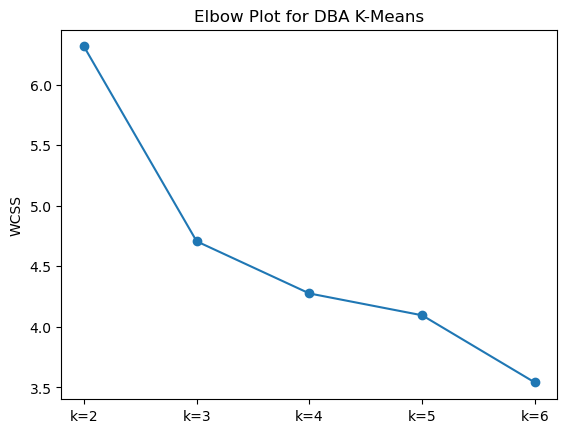

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,calinski_harabasz_dtw,davies_bouldin_dtw
k=4,4.275632,0.198859,2.10605,1.286217


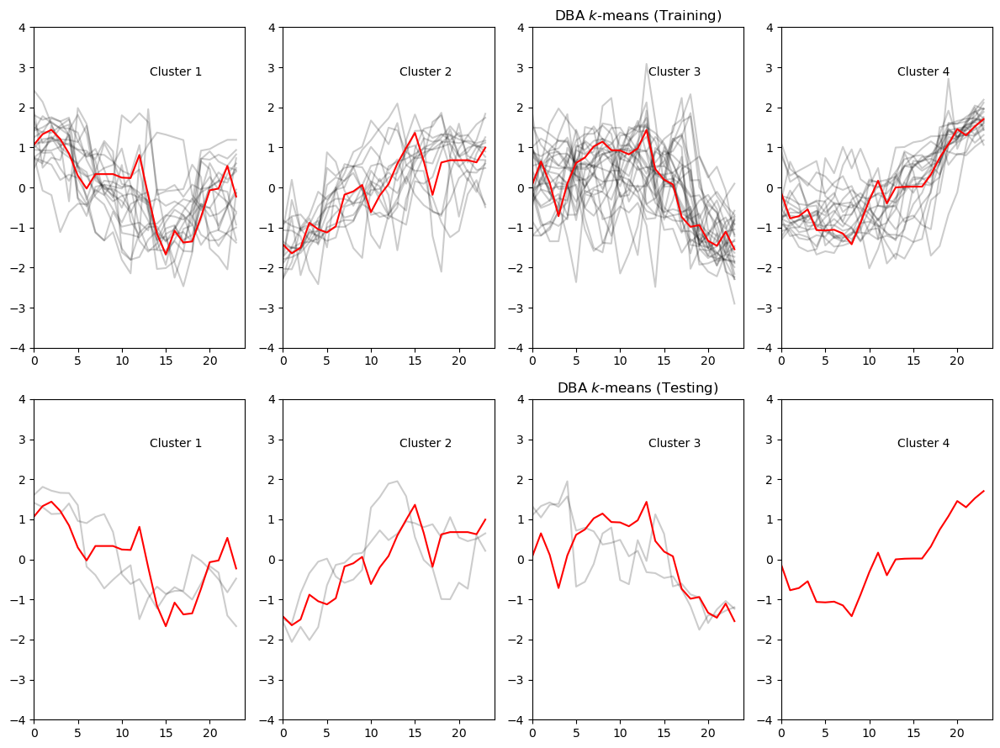

Min Length for train & test time series: 24

DBA k-means

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,calinski_harabasz,calinski_harabasz_dtw,davies_bouldin,davies_bouldin_dtw
k=2,5.996692,0.465032,51.325209,89.789584,1.122336,0.826838
k=3,5.010514,0.347191,36.324726,46.014345,1.430783,1.107665
k=4,4.125881,0.322668,29.410725,39.223778,1.635455,1.067765
k=5,3.751335,0.269204,24.718269,28.636246,1.850601,1.507288
k=6,3.510581,0.260059,18.788836,21.192668,2.161998,1.347734


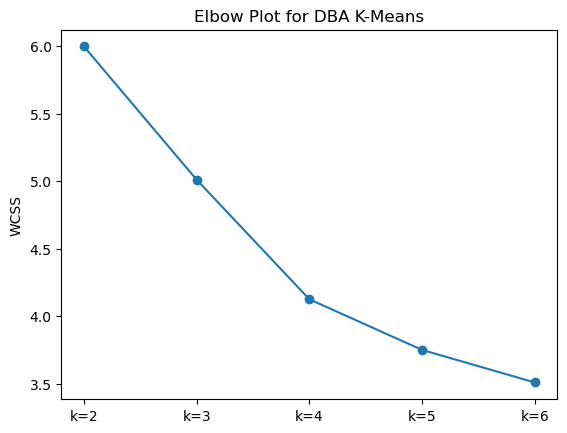

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,calinski_harabasz_dtw,davies_bouldin_dtw
k=4,4.125881,0.253447,1.23978,1.02458


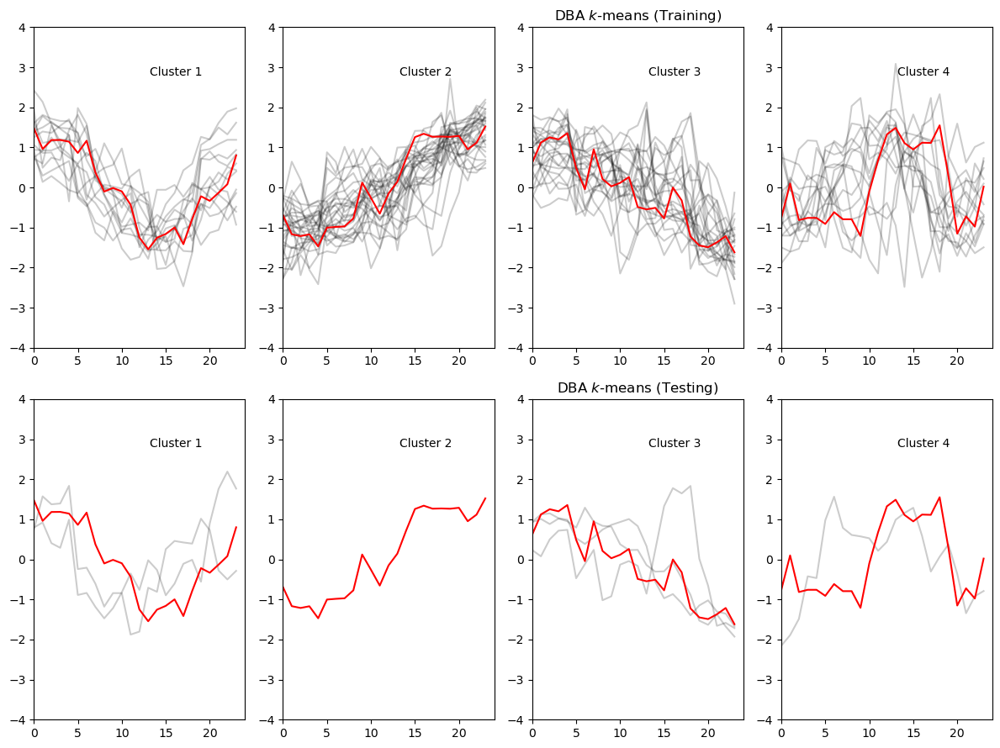

Min Length for train & test time series: 24

DBA k-means

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,calinski_harabasz,calinski_harabasz_dtw,davies_bouldin,davies_bouldin_dtw
k=2,6.254369,0.462627,48.957574,75.379969,1.166292,0.802571
k=3,5.134454,0.321774,29.297387,44.139107,1.524719,1.191813
k=4,4.190819,0.314096,29.300126,41.398176,1.526551,1.084886
k=5,3.835545,0.300258,25.385847,29.901813,1.612147,1.366626
k=6,3.496204,0.222585,21.514111,25.312062,1.809380,1.458073


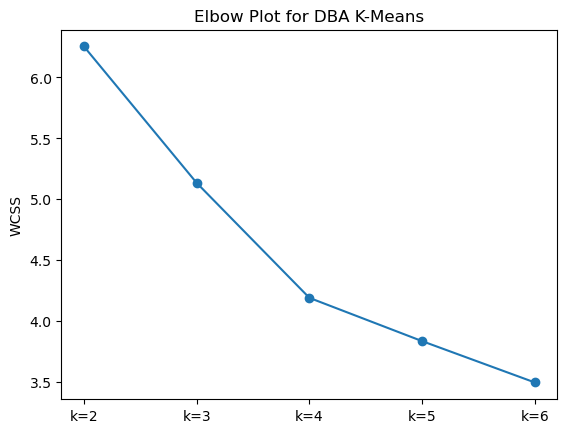

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,calinski_harabasz_dtw,davies_bouldin_dtw
k=4,4.190819,0.488488,22.472883,0.233728


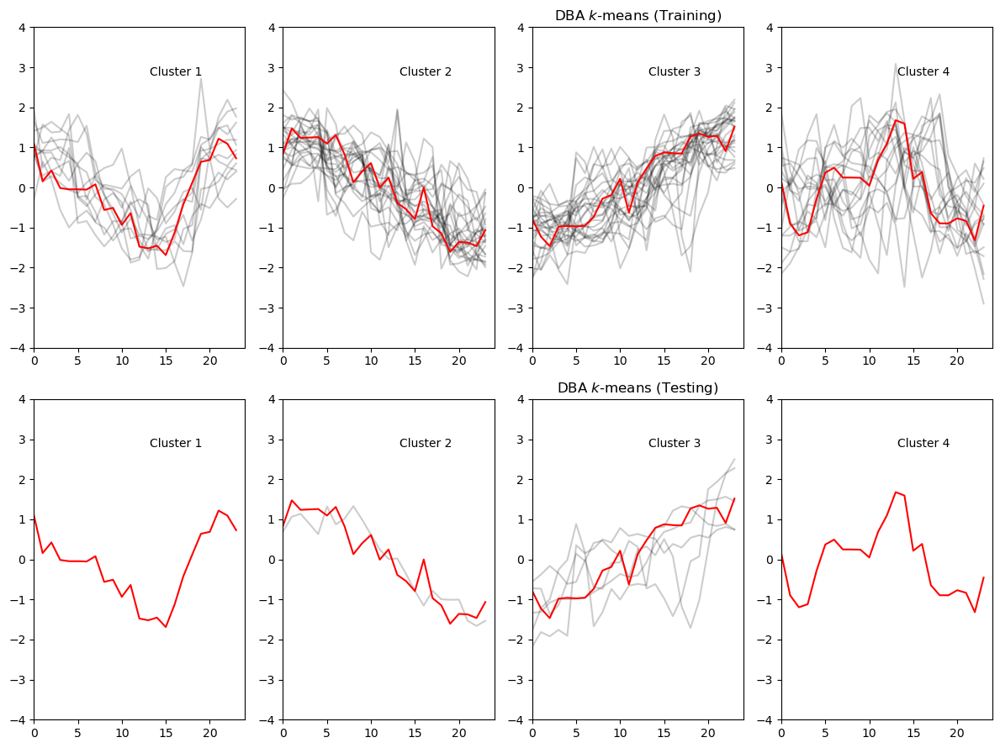

Min Length for train & test time series: 24

DBA k-means

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,calinski_harabasz,calinski_harabasz_dtw,davies_bouldin,davies_bouldin_dtw
k=2,6.162564,0.482041,54.361603,56.918877,1.127310,0.895532
k=3,5.021267,0.339348,35.895577,35.587592,1.696370,1.182996
k=4,4.239713,0.300811,29.244478,40.267453,1.577429,1.053276
k=5,3.682549,0.199998,25.659636,33.044311,1.748013,1.344411
k=6,3.479665,0.199284,22.325947,26.702322,1.685346,1.258645


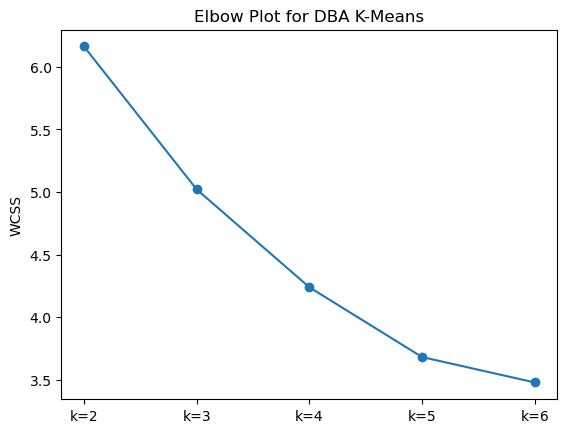

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,calinski_harabasz_dtw,davies_bouldin_dtw
k=4,4.239713,0.421603,1.770532,0.932835


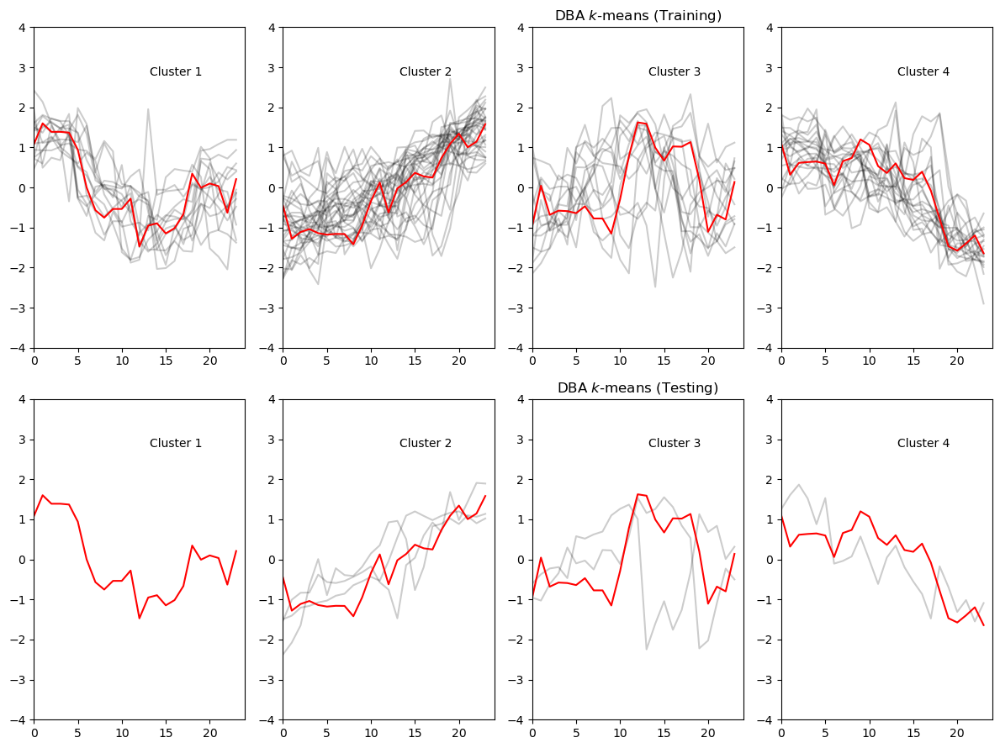

[(array([1, 2, 2, 3, 2, 2, 3, 1, 2, 0, 2, 2, 2, 2, 0, 2, 3, 2, 2, 2, 3, 0,
       1, 0, 1, 3, 1, 3, 2, 2, 0, 3, 0, 2, 2, 2, 2, 3, 1, 0, 3, 0, 1, 3,
       0, 2, 0, 0, 3, 3, 0, 3, 1, 2, 2, 2, 3, 2, 1, 2, 3, 0, 1, 2, 3, 0,
       0, 3, 0, 3, 3, 1, 2, 3, 0, 1, 1, 1], dtype=int64), array([0, 2, 2, 1, 1, 0], dtype=int64)), (array([1, 1, 3, 0, 2, 2, 2, 3, 0, 2, 1, 3, 2, 2, 1, 0, 1, 0, 1, 1, 3, 1,
       2, 2, 2, 1, 2, 2, 2, 3, 3, 1, 1, 2, 1, 0, 1, 1, 0, 2, 3, 3, 1, 1,
       0, 1, 1, 3, 2, 2, 0, 2, 1, 3, 1, 0, 1, 3, 0, 0, 2, 1, 0, 1, 1, 1,
       2, 1, 2, 1, 3, 3, 2, 2, 2, 3, 1, 0], dtype=int64), array([2, 2, 0, 0, 3, 2], dtype=int64)), (array([3, 3, 0, 1, 2, 3, 1, 1, 2, 1, 2, 0, 2, 2, 3, 2, 1, 3, 1, 2, 1, 1,
       3, 3, 3, 2, 2, 1, 2, 1, 2, 2, 1, 1, 3, 3, 2, 2, 0, 2, 2, 3, 1, 1,
       0, 1, 2, 3, 2, 0, 2, 3, 0, 0, 1, 2, 0, 2, 0, 2, 1, 2, 1, 2, 3, 2,
       1, 1, 1, 3, 2, 1, 3, 1, 0, 0, 3, 1], dtype=int64), array([1, 2, 2, 2, 2, 2], dtype=int64)), (array([3, 3, 1, 0, 1, 0, 1, 1, 2, 1, 3, 3

In [37]:
dba_kmeans_pred_results = generate_train_test_split_results(df, dba_k_means_clustering)
print(dba_kmeans_pred_results)

In [38]:
plot_clustering_predictions_subplots(df, dba_kmeans_pred_results)

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2617 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196


#### DBA K-Medoids

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2617 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196
Min Length for train & test time series: 24

DTW $K$-Medoids 

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,davies_bouldin,davies_bouldin_medoids_dtw
k=2,203.324878,0.429531,1.307127,0.695080
k=3,176.933257,0.348585,1.529169,0.957648
k=4,166.790998,0.308311,1.803697,1.110854
k=5,156.467445,0.220542,1.803917,1.178315
k=6,146.873060,0.211431,1.822527,1.147107


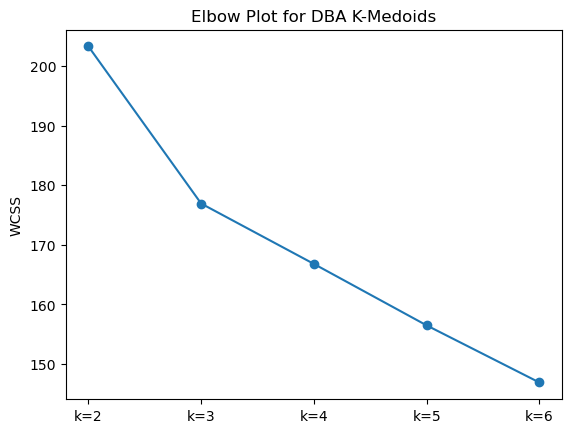

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,davies_bouldin_medoids_dtw
k=4,166.790998,0.416349,1.388927


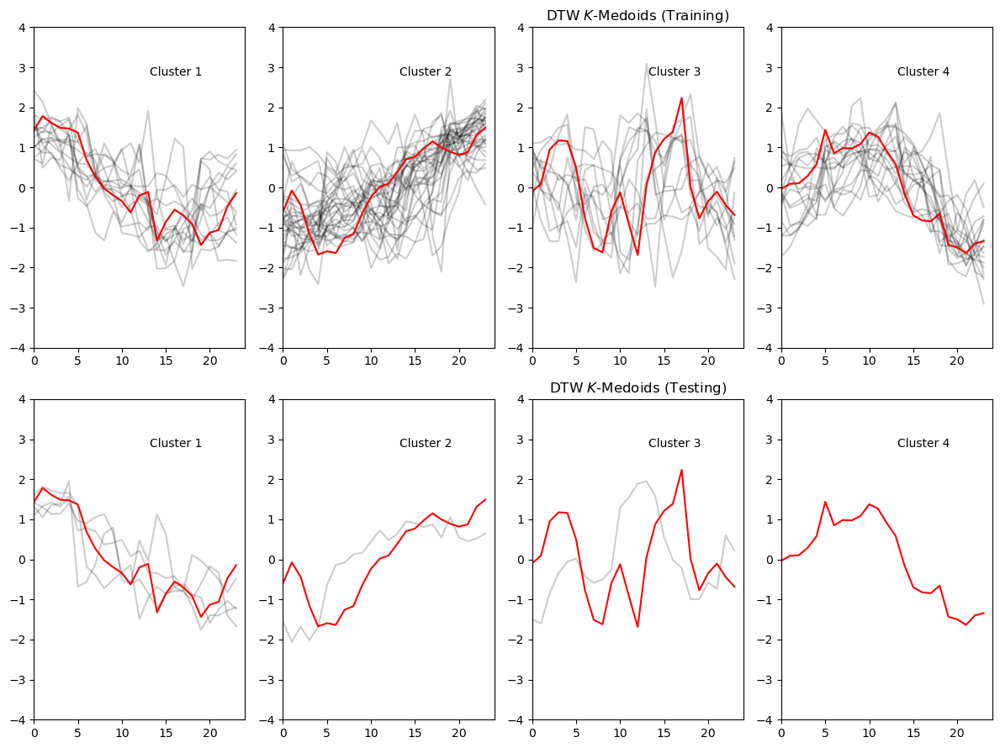

Min Length for train & test time series: 24

DTW $K$-Medoids 

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,davies_bouldin,davies_bouldin_medoids_dtw
k=2,198.497342,0.444515,1.198343,0.710694
k=3,176.449602,0.353673,1.583028,0.946309
k=4,162.725722,0.310471,1.684124,1.120698
k=5,154.948992,0.257038,1.923786,1.217732
k=6,145.433326,0.208310,1.756241,1.131848


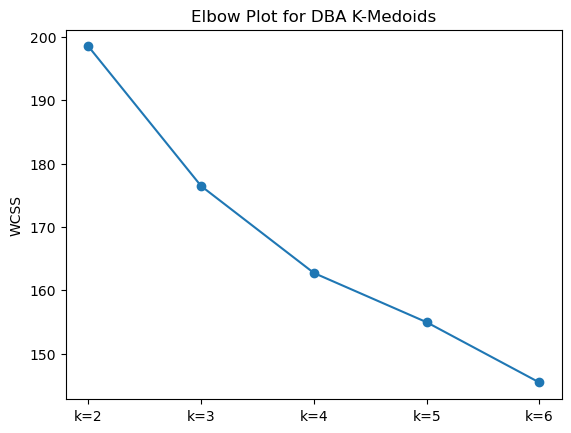

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,davies_bouldin_medoids_dtw
k=4,162.725722,0.292599,0.826128


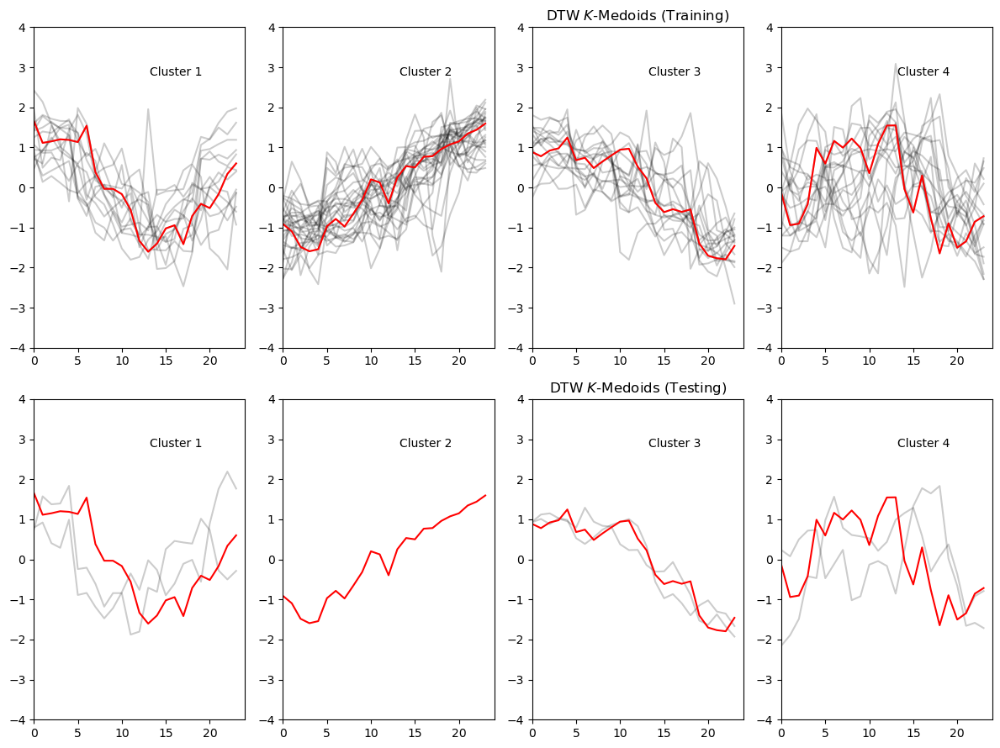

Min Length for train & test time series: 24

DTW $K$-Medoids 

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,davies_bouldin,davies_bouldin_medoids_dtw
k=2,200.052598,0.433162,1.231076,0.715362
k=3,180.250703,0.339301,1.682258,0.976613
k=4,163.446280,0.315672,1.684199,1.110300
k=5,153.824117,0.211504,1.867347,1.255496
k=6,144.651829,0.225473,1.657756,1.126273


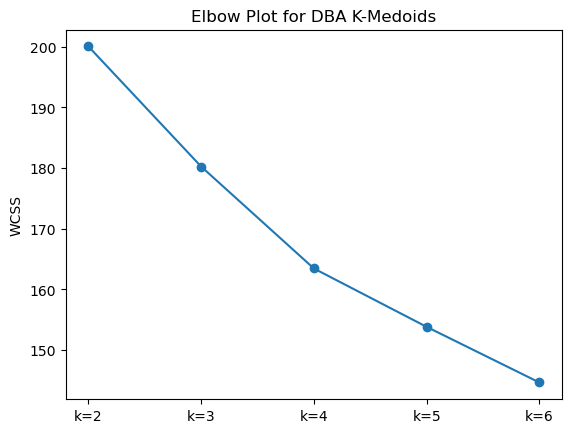

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,davies_bouldin_medoids_dtw
k=4,163.44628,0.488488,0.251886


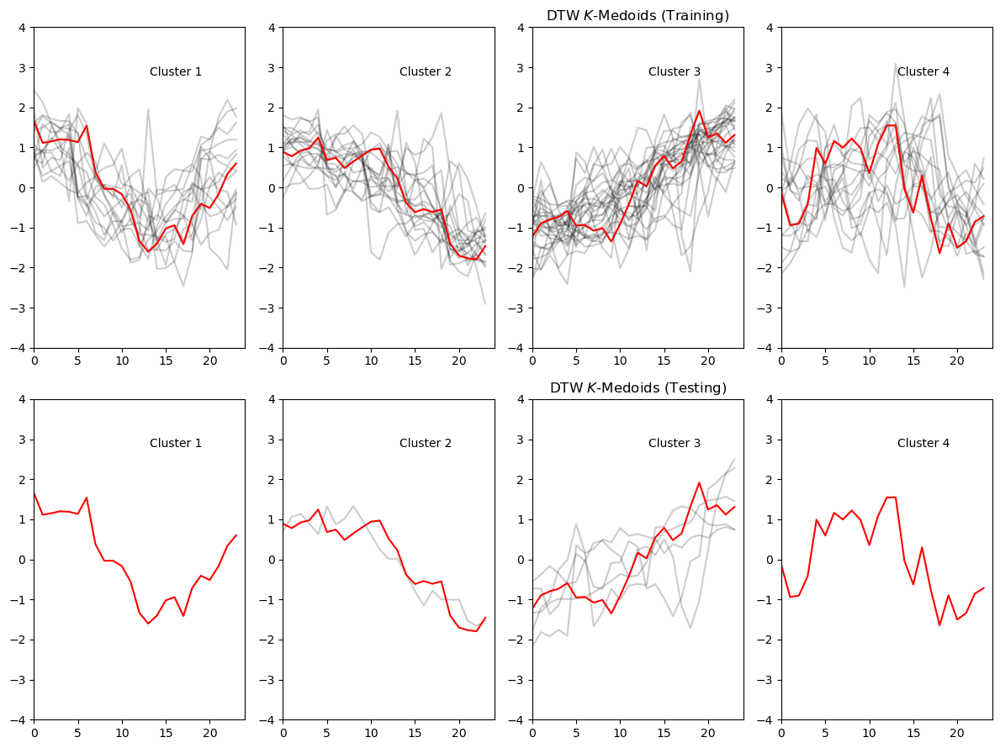

Min Length for train & test time series: 24

DTW $K$-Medoids 

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,davies_bouldin,davies_bouldin_medoids_dtw
k=2,199.505206,0.475391,1.145430,0.766203
k=3,179.410048,0.322438,1.674276,1.153596
k=4,162.632434,0.321236,1.411644,1.016740
k=5,150.542697,0.224725,1.851400,1.253889
k=6,144.661336,0.188073,1.915346,1.262716


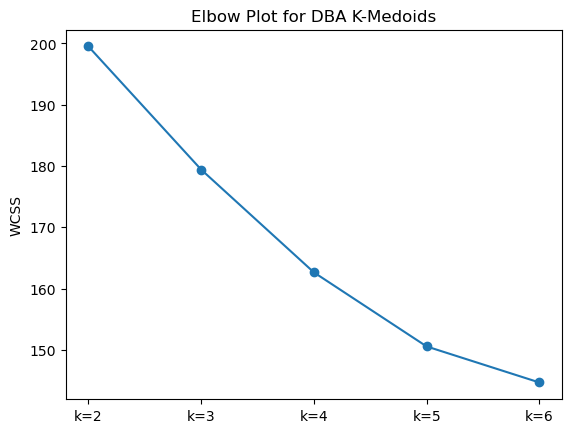

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,davies_bouldin_medoids_dtw
k=4,162.632434,0.421603,0.816299


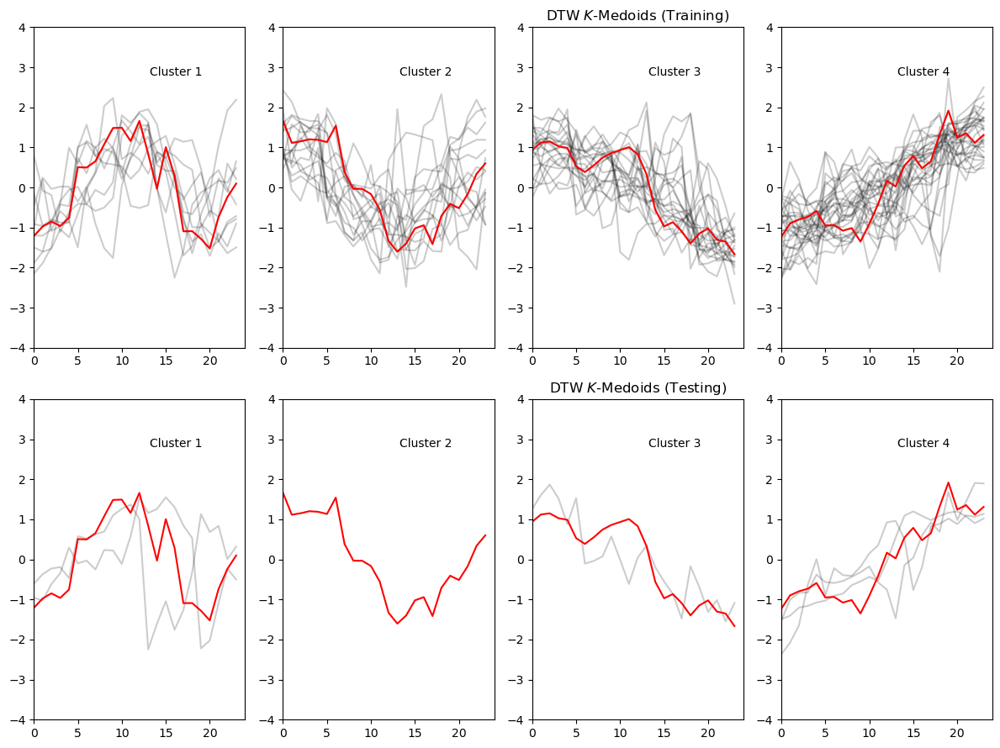

[(array([3, 3, 3, 1, 2, 2, 1, 1, 3, 0, 2, 3, 2, 2, 0, 3, 1, 2, 3, 0, 1, 0,
       1, 0, 1, 1, 2, 1, 3, 3, 0, 1, 0, 3, 3, 3, 2, 1, 1, 0, 1, 0, 1, 1,
       0, 3, 2, 2, 1, 1, 0, 1, 1, 3, 3, 0, 1, 0, 1, 3, 1, 0, 1, 3, 1, 0,
       2, 1, 1, 1, 1, 1, 3, 1, 2, 1, 1, 1], dtype=int64), array([0, 0, 0, 2, 1, 0], dtype=int64)), (array([1, 1, 3, 0, 3, 3, 3, 3, 0, 2, 1, 3, 2, 2, 1, 0, 1, 0, 1, 1, 3, 1,
       2, 2, 2, 1, 2, 2, 3, 3, 3, 1, 1, 2, 1, 0, 1, 1, 0, 2, 3, 3, 1, 1,
       0, 1, 1, 3, 2, 2, 0, 2, 1, 3, 1, 0, 1, 3, 0, 0, 0, 1, 0, 1, 1, 1,
       3, 1, 2, 1, 3, 1, 2, 2, 2, 3, 1, 0], dtype=int64), array([3, 2, 0, 0, 3, 2], dtype=int64)), (array([3, 3, 0, 1, 2, 3, 1, 1, 2, 0, 2, 0, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1,
       3, 3, 3, 2, 2, 1, 2, 0, 2, 2, 0, 1, 3, 3, 2, 2, 0, 2, 2, 3, 1, 1,
       0, 1, 2, 3, 2, 0, 2, 3, 0, 0, 0, 2, 0, 2, 2, 2, 3, 2, 1, 2, 3, 2,
       1, 1, 1, 3, 2, 0, 3, 1, 0, 0, 3, 1], dtype=int64), array([1, 2, 2, 2, 2, 2], dtype=int64)), (array([2, 2, 3, 1, 3, 1, 3, 3, 0, 3, 2, 2

In [42]:
dba_kmedoids_pred_results = generate_train_test_split_results(df, dba_k_medoids_clustering)
print(dba_kmedoids_pred_results)

In [43]:
plot_clustering_predictions_subplots(df, dba_kmeans_pred_results)

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2617 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196


#### DTW Hierarchical Clustering

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2617 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196
Min Length for train & test time series: 24

DTW Hierarchical Clustering 

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


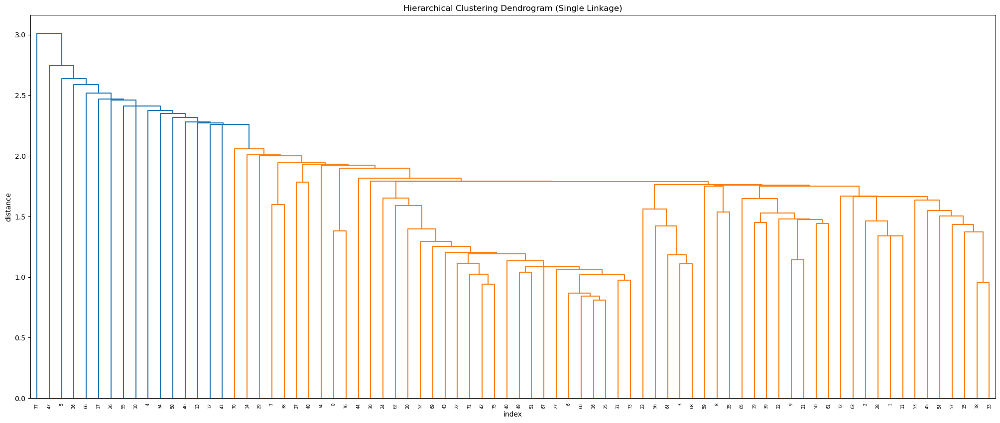

Determined Optimal Number of Clusters: 6
Testing Results


,silhouette,calinski_harabasz,davies_bouldin
k=6,-0.259558,0.98546,0.998331


Cluster 1 number of entries 73/78


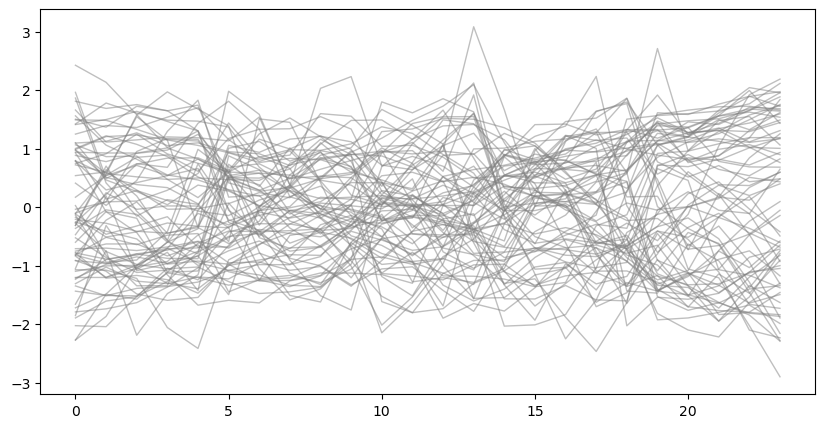

Cluster 4 number of entries 1/78


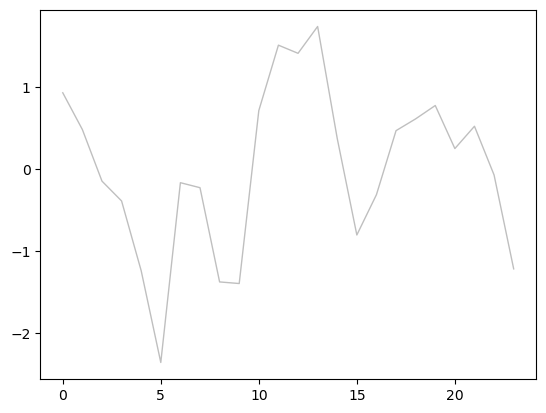

Cluster 3 number of entries 1/78


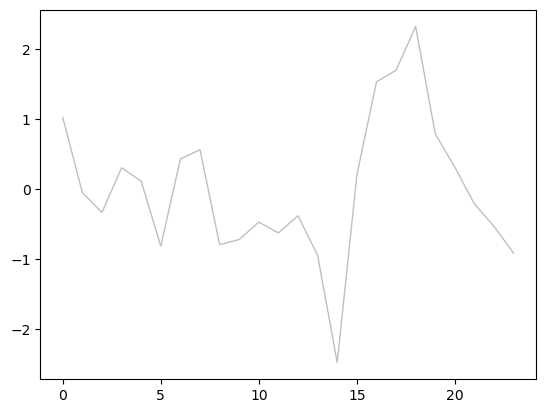

Cluster 5 number of entries 1/78


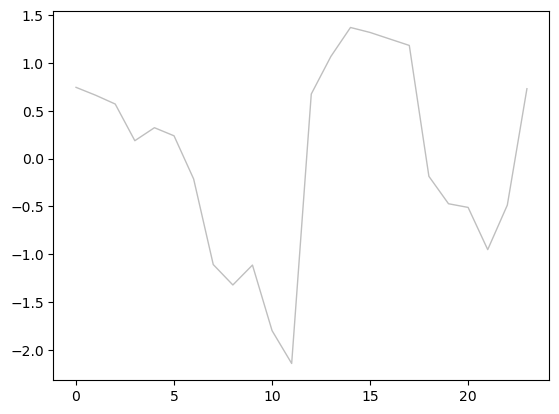

Cluster 2 number of entries 1/78


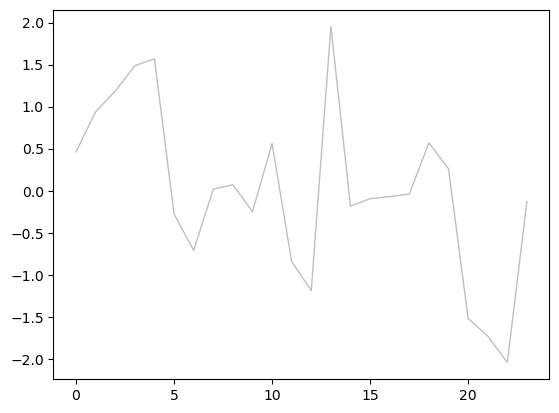

Cluster 6 number of entries 1/78


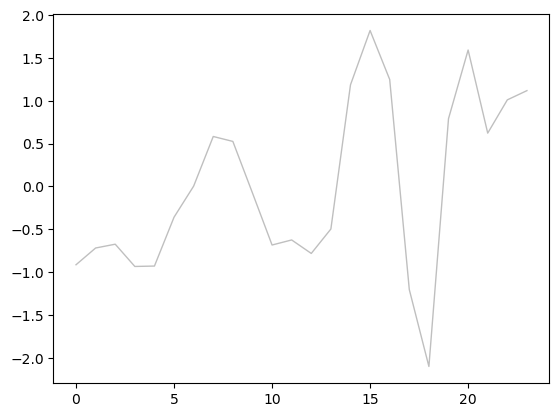

Min Length for train & test time series: 24

DTW Hierarchical Clustering 

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


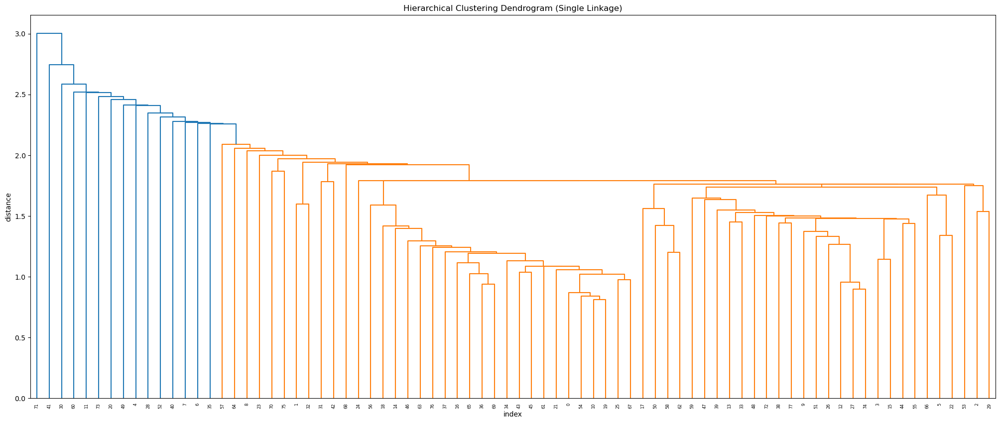

Determined Optimal Number of Clusters: 4
Testing Results


,silhouette,calinski_harabasz,davies_bouldin
k=4,-0.223655,0.971437,1.003148


Cluster 1 number of entries 75/78


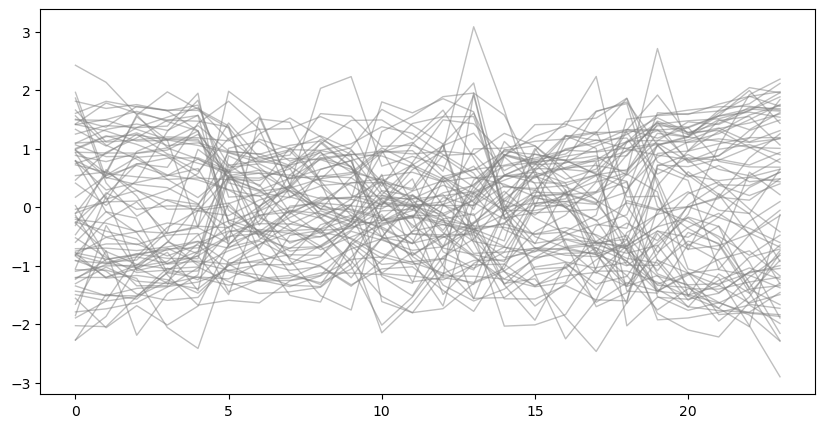

Cluster 2 number of entries 1/78


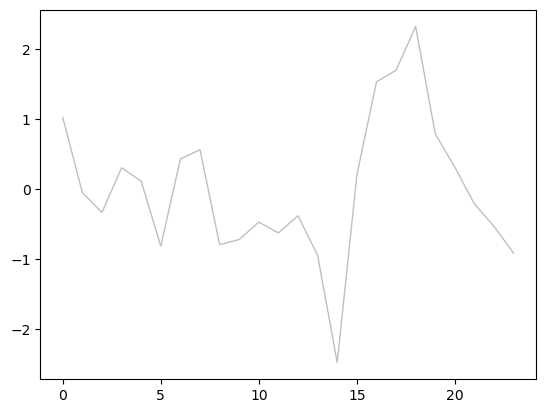

Cluster 3 number of entries 1/78


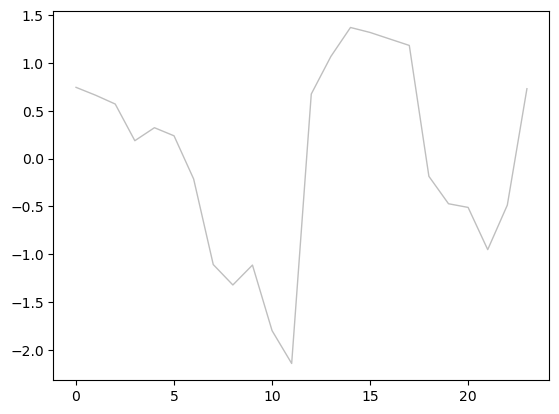

Cluster 4 number of entries 1/78


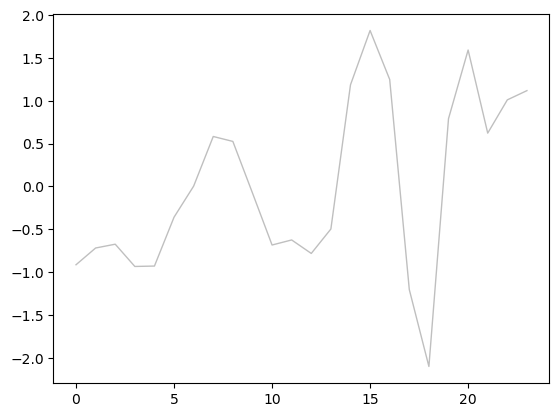

Min Length for train & test time series: 24

DTW Hierarchical Clustering 

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


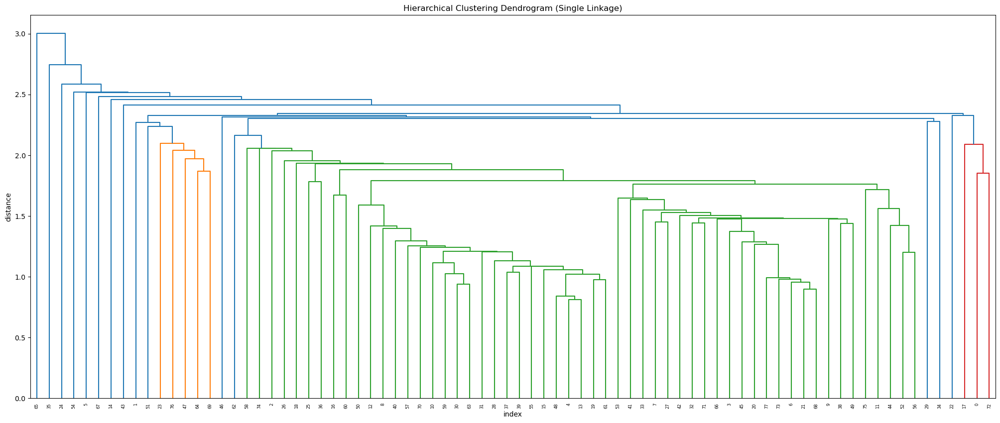

Determined Optimal Number of Clusters: 4
Testing Results


,silhouette,calinski_harabasz,davies_bouldin
k=4,-0.220424,0.976591,1.001541


Cluster 1 number of entries 75/78


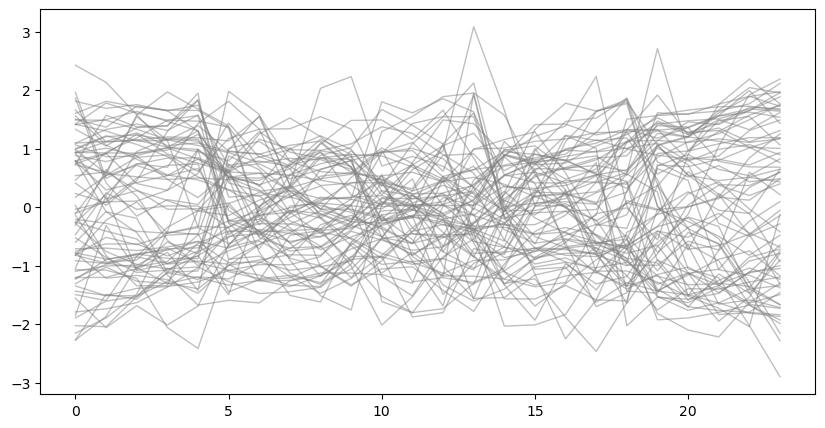

Cluster 2 number of entries 1/78


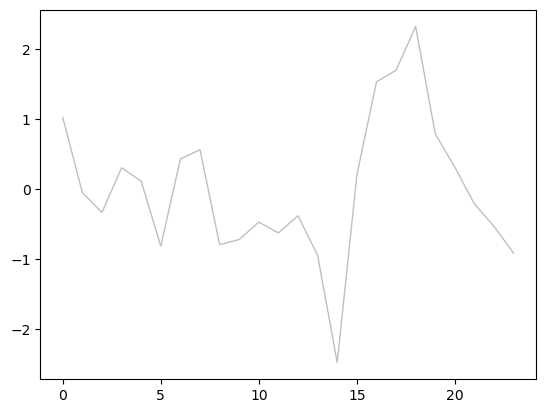

Cluster 3 number of entries 1/78


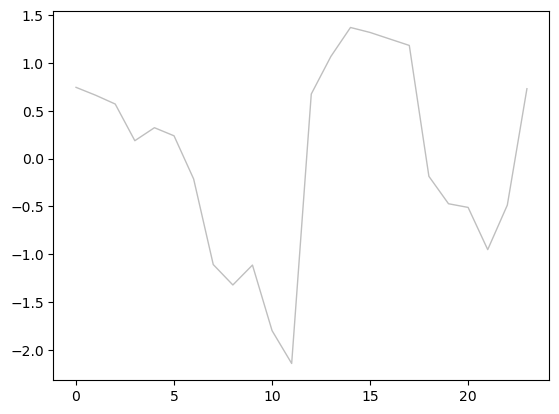

Cluster 4 number of entries 1/78


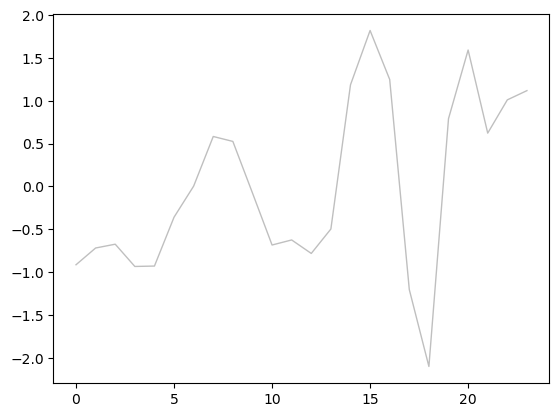

Min Length for train & test time series: 24

DTW Hierarchical Clustering 

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


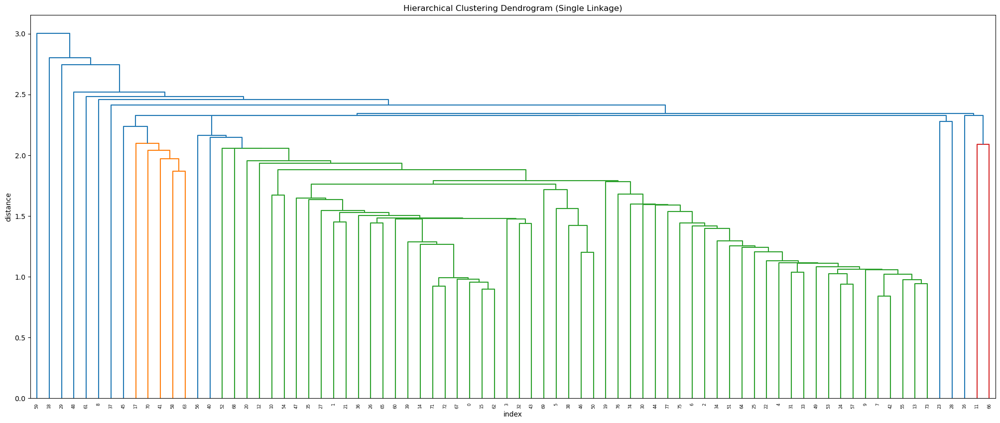

Determined Optimal Number of Clusters: 4
Testing Results


,silhouette,calinski_harabasz,davies_bouldin
k=4,-0.223469,0.976134,1.003491


Cluster 1 number of entries 75/78


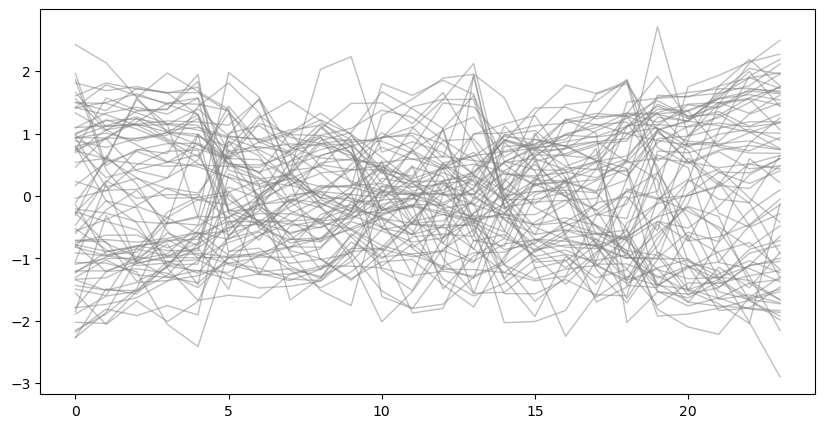

Cluster 3 number of entries 1/78


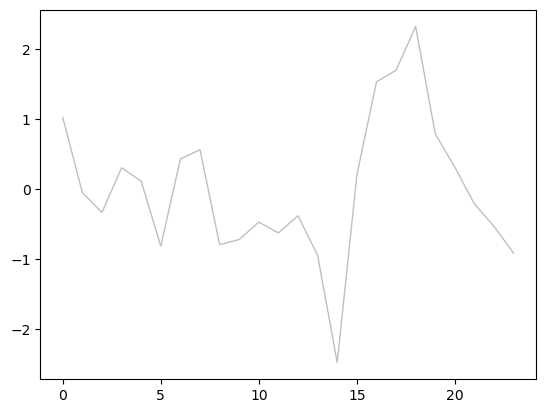

Cluster 2 number of entries 1/78


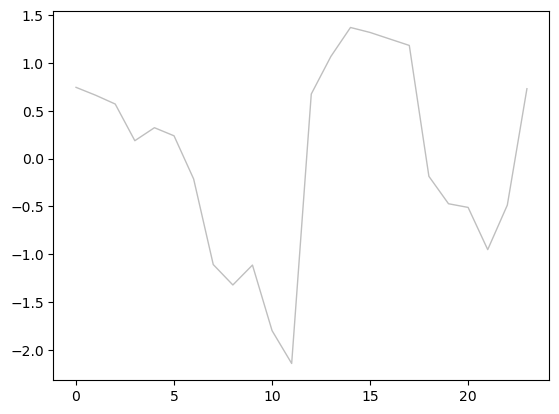

Cluster 4 number of entries 1/78


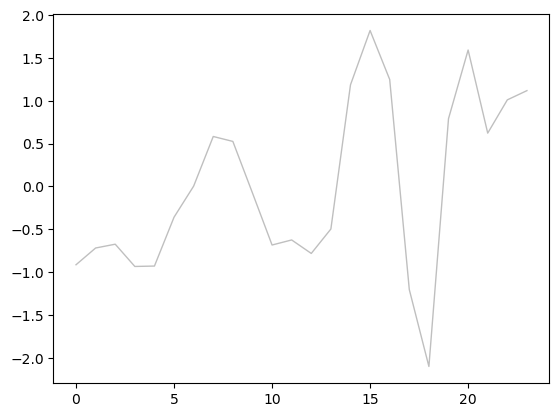

[array([1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 6], dtype=int32), array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1, 1], dtype=int32), array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int32), array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 

In [44]:
hierarchical_pred_results = generate_train_test_split_results(df, dtw_hierarchical_clustering)
print(hierarchical_pred_results)

#### DBA K-Means on Differenced Dataset

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2616 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196
Min Length for train & test time series: 24

DBA k-means

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,calinski_harabasz,calinski_harabasz_dtw,davies_bouldin,davies_bouldin_dtw
k=2,6.049679,0.190424,10.052333,58.576743,2.734018,1.455784
k=3,4.988009,0.146195,7.590507,30.012388,2.816585,1.836112
k=4,4.512074,0.140994,5.677941,21.234414,3.134888,1.515501
k=5,4.237691,0.126191,4.814570,15.144898,3.209257,1.653672
k=6,3.754817,0.138394,6.598912,14.895270,2.648906,1.548962


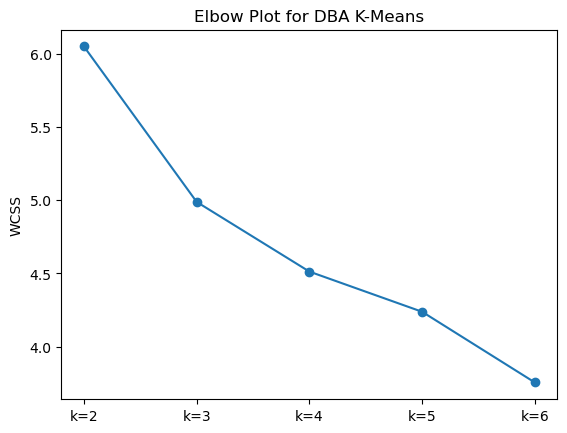

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,calinski_harabasz_dtw,davies_bouldin_dtw
k=4,4.512074,-0.205938,1.006909,1.172842


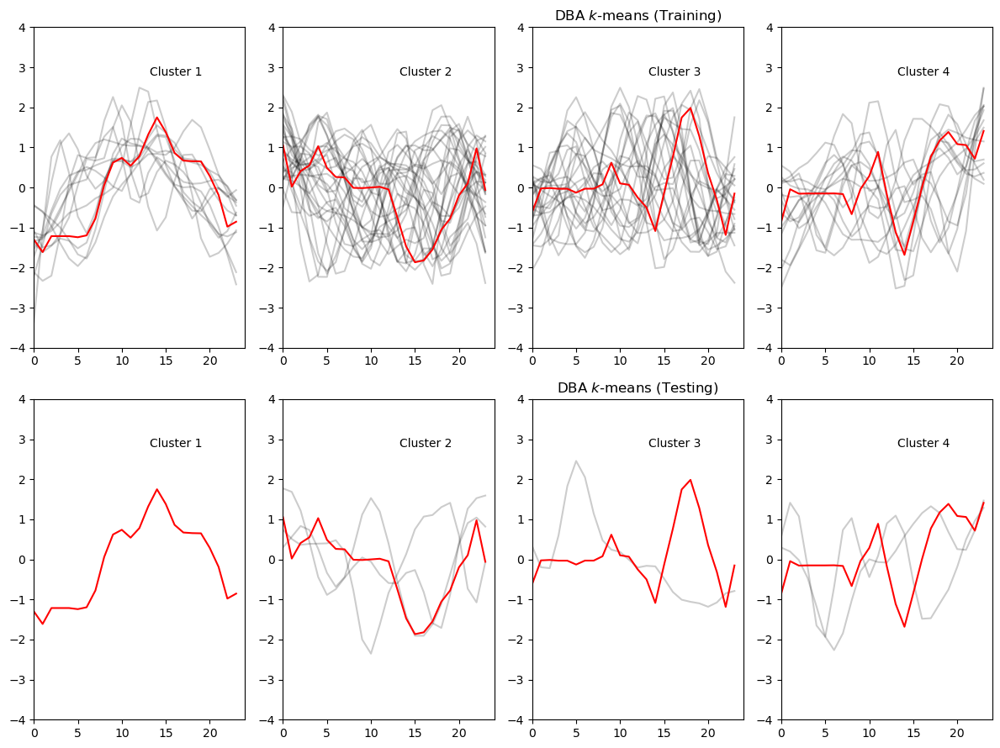

Min Length for train & test time series: 24

DBA k-means

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,calinski_harabasz,calinski_harabasz_dtw,davies_bouldin,davies_bouldin_dtw
k=2,6.447038,0.240861,9.086201,61.692847,2.695550,1.676019
k=3,4.830280,0.156889,7.277844,28.434222,3.096428,1.414344
k=4,4.453116,0.141623,6.999523,17.932186,2.875281,1.426244
k=5,3.807308,0.188273,7.079946,13.804780,2.652729,1.262175
k=6,3.583873,0.174975,7.157982,12.661816,2.454925,1.318077


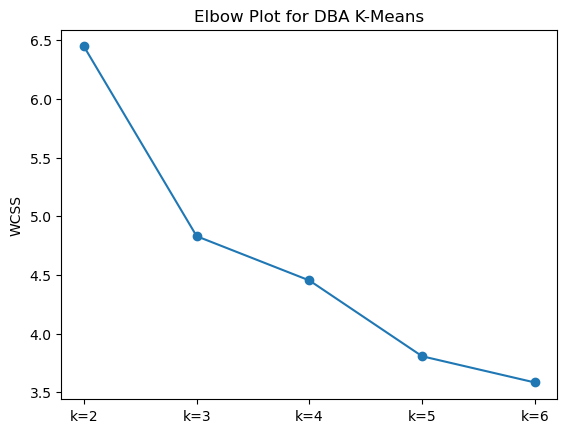

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,calinski_harabasz_dtw,davies_bouldin_dtw
k=4,4.453116,0.025276,0.665269,1.101988


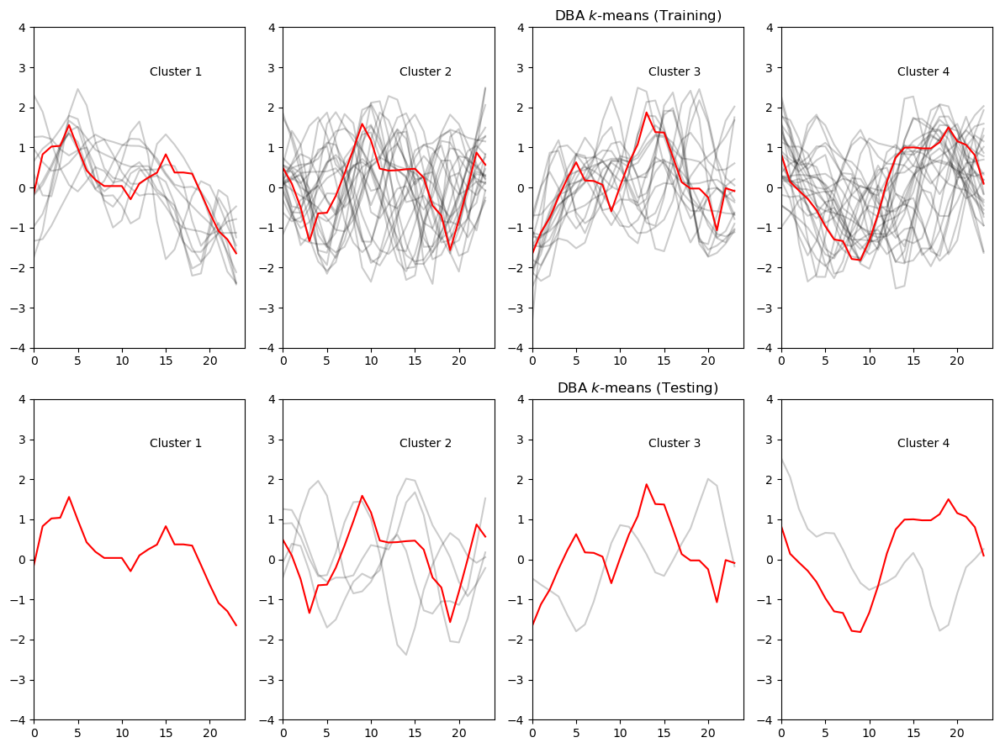

Min Length for train & test time series: 24

DBA k-means

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,calinski_harabasz,calinski_harabasz_dtw,davies_bouldin,davies_bouldin_dtw
k=2,6.137099,0.179100,9.666190,57.408009,2.780131,1.527590
k=3,5.182430,0.130480,7.604560,26.281211,2.958549,1.509248
k=4,4.662159,0.130961,6.739923,20.470585,2.665369,1.355951
k=5,3.988285,0.151028,5.100606,15.337535,2.896436,1.430831
k=6,3.602194,0.156212,6.591918,14.754367,2.488919,1.398937


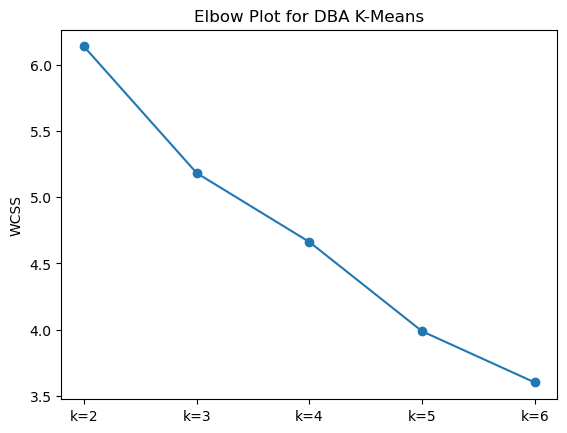

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,calinski_harabasz_dtw,davies_bouldin_dtw
k=4,4.662159,-0.083906,1.307088,1.493056


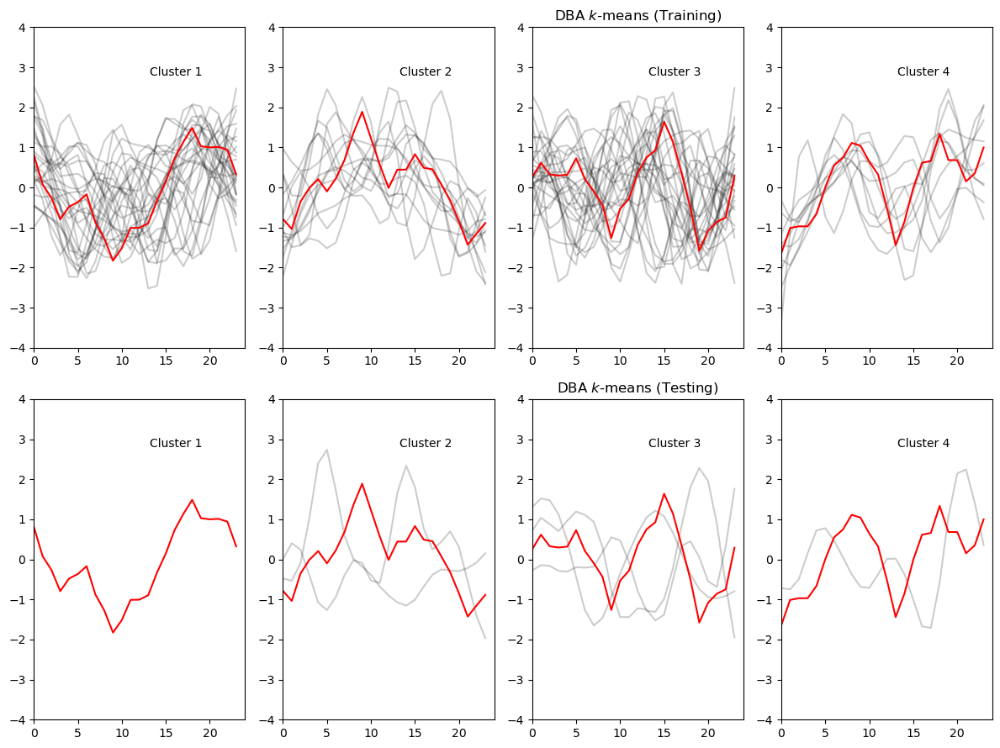

Min Length for train & test time series: 24

DBA k-means

X_train shape: (78, 24, 1)
X_test shape: (6, 24, 1)


,wcss,silhouette,calinski_harabasz,calinski_harabasz_dtw,davies_bouldin,davies_bouldin_dtw
k=2,5.798820,0.196036,8.201918,57.072065,3.020586,1.568047
k=3,5.163992,0.133348,6.692280,31.992032,2.889628,1.439636
k=4,4.497638,0.136888,5.718277,14.431810,2.901880,1.580628
k=5,4.094184,0.162561,6.691441,14.109808,2.381160,1.395650
k=6,3.671814,0.148115,6.387039,16.301810,2.333537,1.502776


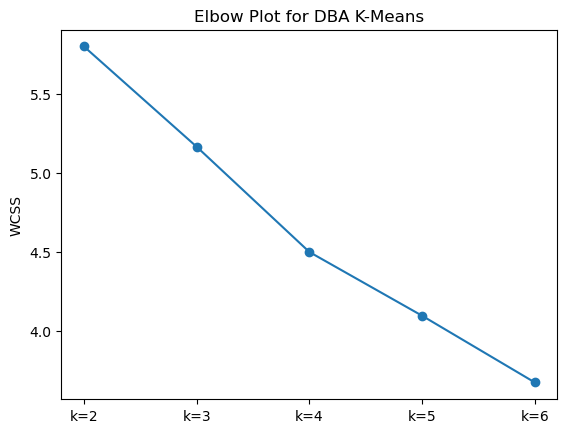

Finding optimal k based on wcss
Optimal k is found to be 4
Testing Results


,wcss,silhouette,calinski_harabasz_dtw,davies_bouldin_dtw
k=4,4.497638,0.084468,0.635647,2.357725


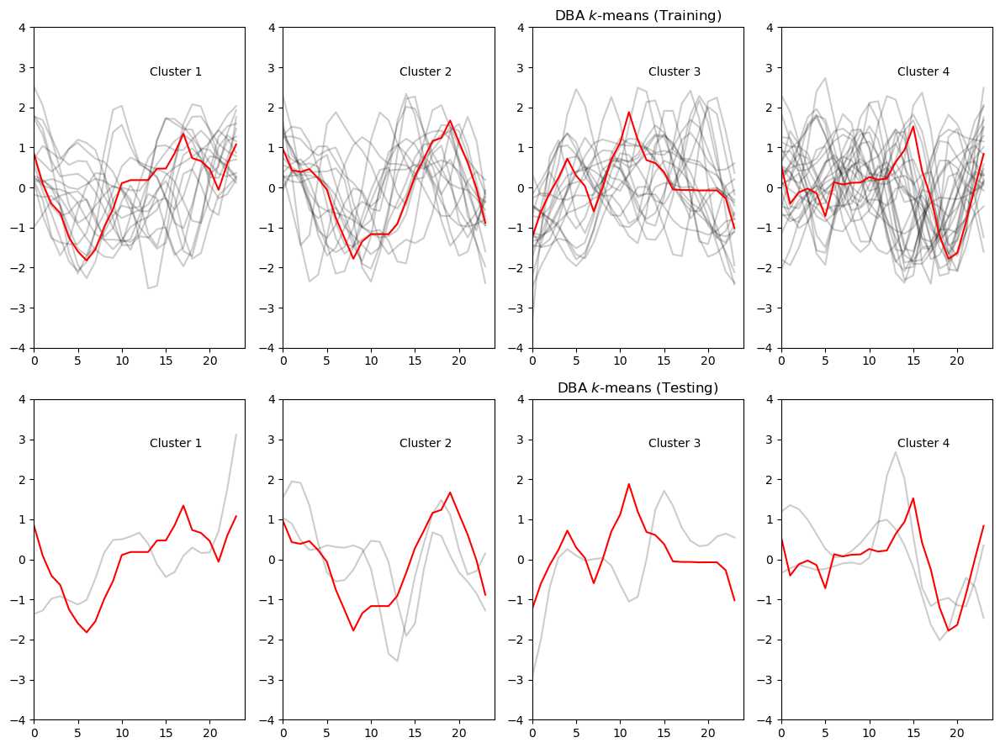

[(array([1, 2, 2, 2, 2, 0, 0, 1, 1, 1, 2, 2, 2, 2, 2, 3, 1, 2, 1, 3, 1, 1,
       0, 3, 2, 0, 3, 2, 1, 0, 2, 3, 1, 1, 2, 1, 2, 1, 1, 3, 2, 1, 0, 0,
       0, 1, 3, 2, 3, 1, 3, 1, 0, 3, 1, 3, 1, 1, 2, 1, 1, 1, 2, 1, 3, 3,
       3, 2, 1, 0, 2, 2, 0, 2, 1, 0, 1, 1], dtype=int64), array([1, 3, 1, 1, 2, 3], dtype=int64)), (array([2, 1, 3, 3, 2, 0, 2, 0, 2, 1, 3, 1, 0, 2, 3, 3, 0, 3, 1, 3, 1, 1,
       0, 2, 2, 2, 1, 3, 1, 0, 2, 3, 3, 3, 3, 3, 0, 2, 2, 1, 1, 1, 1, 3,
       3, 3, 2, 1, 0, 2, 3, 1, 1, 3, 1, 3, 2, 3, 3, 1, 1, 1, 3, 3, 3, 0,
       2, 2, 3, 2, 1, 1, 1, 1, 3, 1, 0, 3], dtype=int64), array([1, 1, 1, 2, 1, 3], dtype=int64)), (array([2, 1, 3, 0, 0, 2, 1, 3, 0, 0, 1, 0, 1, 0, 2, 2, 2, 1, 1, 3, 0, 0,
       2, 2, 2, 0, 0, 0, 2, 0, 1, 1, 1, 2, 3, 2, 3, 2, 0, 0, 1, 3, 2, 3,
       0, 2, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 0, 1, 3, 3, 2, 1, 2, 2,
       2, 2, 0, 2, 1, 0, 2, 2, 2, 0, 2, 0], dtype=int64), array([2, 1, 3, 1, 2, 2], dtype=int64)), (array([3, 3, 1, 1, 2, 0, 1, 2, 3, 0, 1, 2

In [48]:
dba_kmeans_pred_results_differenced = generate_train_test_split_results(df_differenced, dba_k_means_clustering)
print(dba_kmeans_pred_results_differenced)

In [49]:
# Apply cluster labels directly on original dataset
plot_clustering_predictions_subplots(df, dba_kmeans_pred_results_differenced)

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2617 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196


In [50]:
# Apply cluster labels directly on differenced dataset
plot_clustering_predictions_subplots(df_differenced, dba_kmeans_pred_results_differenced)

Train period: 2022-01-31 - 2023-07-31 , Test period 2023-07-31 - 2023-09-11 # train records 2616 , # test records 203
Train period: 2022-03-14 - 2023-09-11 , Test period 2023-09-11 - 2023-10-23 # train records 2617 , # test records 210
Train period: 2022-04-25 - 2023-10-23 , Test period 2023-10-23 - 2023-12-04 # train records 2624 , # test records 199
Train period: 2022-06-06 - 2023-12-04 , Test period 2023-12-04 - 2024-01-15 # train records 2620 , # test records 196


### Additional Miscellaneous Analysis

#### Imputation of missing holiday and weekend data

In [53]:
def generate_trading_day_index(date):
    if date.dst() == datetime.timedelta(hours = 1):
        hourly_time = ['09:30:00-0400', '10:30:00-04:00', '11:30:00-04:00', '12:30:00-04:00', '13:30:00-04:00', '14:30:00-04:00', '15:30:00-04:00']
    else:
        hourly_time = ['09:30:00-0500', '10:30:00-05:00', '11:30:00-05:00', '12:30:00-05:00', '13:30:00-05:00', '14:30:00-05:00', '15:30:00-05:00']
    return [pd.Timestamp(date.strftime('%Y-%m-%d') + ' ' + time, tz='America/New_York') for time in hourly_time]


# Impute for holidays
def impute_holidays(df, holidays):
    '''df has Datetimeindex'''
    for day in holidays:
        day = pd.Timestamp(day)
        if date.today() < day.date() or df.index[0].date() > day.date():
            # Skipping holidays that are beyond todays date or much earlier than dataset's earliest date
            continue
        if day.weekday() == 5 or day.weekday() == 6:
            # Ignoring weekends
            continue
        # Impute holiday prices with the day before's
        print(f"Imputing for day: {day}")
        display(df.loc[df.index.date < day.date()])
        daybefore_price = df.loc[df.index.date < day.date()].Close.iat[-1]
        print(daybefore_price)
        new_df = pd.DataFrame([daybefore_price for i in range(7)], index = generate_trading_day_index(day))
        new_df.columns = ['Close']
        display(new_df)
        df = pd.concat([df, new_df])
        df.sort_index(inplace=True)
        
    return df

# Impute for half days
def impute_halfdays(df):
    tmp_df = df.groupby(pd.Grouper(freq='D')).count()
    halfdays = list(tmp_df.loc[(tmp_df.Close < 7) & (tmp_df.Close != 0)].index)
    print(f"Detected Halfdays to impute: {[x.date() for x in halfdays]}")

    for day in halfdays:
    #     print(day.dst() == datetime.timedelta(hours = 1))
        hourbefore_prices = df.loc[df.index.date == day.date()]
        hourbefore_price = hourbefore_prices.Close.iat[-1]
        indexes = generate_trading_day_index(day)
        filtered_indexes = []
        prices = []
        for index in indexes:
            if hourbefore_prices.loc[hourbefore_prices.index == index].empty:
                prices.append(hourbefore_price)
                filtered_indexes.append(index)

        new_df = pd.DataFrame(prices, index = filtered_indexes)
        new_df.columns = ['Close']
        display(new_df)
        df = pd.concat([df, new_df])
        df.sort_index(inplace=True)
        
    return df

imputed_df = df.copy()

imputed_df = impute_holidays(imputed_df, nyse_holidays)  
print(imputed_df.shape)

imputed_df = impute_halfdays(imputed_df)
print(imputed_df.shape)

Imputing for day: 2024-01-01 00:00:00


,Close
Datetime,
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2023-12-29 11:30:00-05:00,4754.000000
2023-12-29 12:30:00-05:00,4763.370117
2023-12-29 13:30:00-05:00,4768.709961


4772.169921875


,Close
2024-01-01 09:30:00-05:00,4772.169922
2024-01-01 10:30:00-05:00,4772.169922
2024-01-01 11:30:00-05:00,4772.169922
2024-01-01 12:30:00-05:00,4772.169922
2024-01-01 13:30:00-05:00,4772.169922
2024-01-01 14:30:00-05:00,4772.169922
2024-01-01 15:30:00-05:00,4772.169922


Imputing for day: 2024-01-15 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2024-01-12 11:30:00-05:00,4775.490234
2024-01-12 12:30:00-05:00,4782.299805
2024-01-12 13:30:00-05:00,4785.660156
2024-01-12 14:30:00-05:00,4778.240234


4783.14013671875


,Close
2024-01-15 09:30:00-05:00,4783.140137
2024-01-15 10:30:00-05:00,4783.140137
2024-01-15 11:30:00-05:00,4783.140137
2024-01-15 12:30:00-05:00,4783.140137
2024-01-15 13:30:00-05:00,4783.140137
2024-01-15 14:30:00-05:00,4783.140137
2024-01-15 15:30:00-05:00,4783.140137


Imputing for day: 2024-02-19 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2024-01-19 11:30:00-05:00,4809.129883
2024-01-19 12:30:00-05:00,4825.220215
2024-01-19 13:30:00-05:00,4835.379883
2024-01-19 14:30:00-05:00,4836.979980


4838.9599609375


,Close
2024-02-19 09:30:00-05:00,4838.959961
2024-02-19 10:30:00-05:00,4838.959961
2024-02-19 11:30:00-05:00,4838.959961
2024-02-19 12:30:00-05:00,4838.959961
2024-02-19 13:30:00-05:00,4838.959961
2024-02-19 14:30:00-05:00,4838.959961
2024-02-19 15:30:00-05:00,4838.959961


Imputing for day: 2022-02-21 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2022-02-18 11:30:00-05:00,4349.589844
2022-02-18 12:30:00-05:00,4333.979980
2022-02-18 13:30:00-05:00,4370.640137
2022-02-18 14:30:00-05:00,4351.600098


4348.669921875


,Close
2022-02-21 09:30:00-05:00,4348.669922
2022-02-21 10:30:00-05:00,4348.669922
2022-02-21 11:30:00-05:00,4348.669922
2022-02-21 12:30:00-05:00,4348.669922
2022-02-21 13:30:00-05:00,4348.669922
2022-02-21 14:30:00-05:00,4348.669922
2022-02-21 15:30:00-05:00,4348.669922


Imputing for day: 2022-04-15 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2022-04-14 11:30:00-04:00,4414.080078
2022-04-14 12:30:00-04:00,4412.970215
2022-04-14 13:30:00-04:00,4422.709961
2022-04-14 14:30:00-04:00,4405.839844


4392.43994140625


,Close
2022-04-15 10:30:00-04:00,4392.439941
2022-04-15 11:30:00-04:00,4392.439941
2022-04-15 12:30:00-04:00,4392.439941
2022-04-15 13:30:00-04:00,4392.439941
2022-04-15 14:30:00-04:00,4392.439941
2022-04-15 15:30:00-04:00,4392.439941
2022-04-15 16:30:00-04:00,4392.439941


Imputing for day: 2022-05-30 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2022-05-27 11:30:00-04:00,4127.970215
2022-05-27 12:30:00-04:00,4128.459961
2022-05-27 13:30:00-04:00,4129.859863
2022-05-27 14:30:00-04:00,4148.439941


4158.33984375


,Close
2022-05-30 10:30:00-04:00,4158.339844
2022-05-30 11:30:00-04:00,4158.339844
2022-05-30 12:30:00-04:00,4158.339844
2022-05-30 13:30:00-04:00,4158.339844
2022-05-30 14:30:00-04:00,4158.339844
2022-05-30 15:30:00-04:00,4158.339844
2022-05-30 16:30:00-04:00,4158.339844


Imputing for day: 2022-06-20 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2022-06-17 11:30:00-04:00,3671.250000
2022-06-17 12:30:00-04:00,3686.310059
2022-06-17 13:30:00-04:00,3692.439941
2022-06-17 14:30:00-04:00,3693.899902


3673.6298828125


,Close
2022-06-20 10:30:00-04:00,3673.629883
2022-06-20 11:30:00-04:00,3673.629883
2022-06-20 12:30:00-04:00,3673.629883
2022-06-20 13:30:00-04:00,3673.629883
2022-06-20 14:30:00-04:00,3673.629883
2022-06-20 15:30:00-04:00,3673.629883
2022-06-20 16:30:00-04:00,3673.629883


Imputing for day: 2022-07-04 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2022-07-01 11:30:00-04:00,3781.350098
2022-07-01 12:30:00-04:00,3780.949951
2022-07-01 13:30:00-04:00,3803.340088
2022-07-01 14:30:00-04:00,3814.939941


3825.030029296875


,Close
2022-07-04 10:30:00-04:00,3825.030029
2022-07-04 11:30:00-04:00,3825.030029
2022-07-04 12:30:00-04:00,3825.030029
2022-07-04 13:30:00-04:00,3825.030029
2022-07-04 14:30:00-04:00,3825.030029
2022-07-04 15:30:00-04:00,3825.030029
2022-07-04 16:30:00-04:00,3825.030029


Imputing for day: 2022-09-05 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2022-09-02 11:30:00-04:00,3988.429932
2022-09-02 12:30:00-04:00,3937.550049
2022-09-02 13:30:00-04:00,3938.860107
2022-09-02 14:30:00-04:00,3929.100098


3925.2900390625


,Close
2022-09-05 10:30:00-04:00,3925.290039
2022-09-05 11:30:00-04:00,3925.290039
2022-09-05 12:30:00-04:00,3925.290039
2022-09-05 13:30:00-04:00,3925.290039
2022-09-05 14:30:00-04:00,3925.290039
2022-09-05 15:30:00-04:00,3925.290039
2022-09-05 16:30:00-04:00,3925.290039


Imputing for day: 2022-11-24 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2022-11-23 11:30:00-05:00,4012.689941
2022-11-23 12:30:00-05:00,4011.129883
2022-11-23 13:30:00-05:00,4028.669922
2022-11-23 14:30:00-05:00,4029.040039


4027.860107421875


,Close
2022-11-24 09:30:00-05:00,4027.860107
2022-11-24 10:30:00-05:00,4027.860107
2022-11-24 11:30:00-05:00,4027.860107
2022-11-24 12:30:00-05:00,4027.860107
2022-11-24 13:30:00-05:00,4027.860107
2022-11-24 14:30:00-05:00,4027.860107
2022-11-24 15:30:00-05:00,4027.860107


Imputing for day: 2022-12-26 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2022-12-23 11:30:00-05:00,3838.149902
2022-12-23 12:30:00-05:00,3836.679932
2022-12-23 13:30:00-05:00,3833.250000
2022-12-23 14:30:00-05:00,3837.139893


3844.449951171875


,Close
2022-12-26 09:30:00-05:00,3844.449951
2022-12-26 10:30:00-05:00,3844.449951
2022-12-26 11:30:00-05:00,3844.449951
2022-12-26 12:30:00-05:00,3844.449951
2022-12-26 13:30:00-05:00,3844.449951
2022-12-26 14:30:00-05:00,3844.449951
2022-12-26 15:30:00-05:00,3844.449951


Imputing for day: 2023-01-02 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2022-12-30 11:30:00-05:00,3822.449951
2022-12-30 12:30:00-05:00,3807.899902
2022-12-30 13:30:00-05:00,3806.260010
2022-12-30 14:30:00-05:00,3818.010010


3839.85009765625


,Close
2023-01-02 09:30:00-05:00,3839.850098
2023-01-02 10:30:00-05:00,3839.850098
2023-01-02 11:30:00-05:00,3839.850098
2023-01-02 12:30:00-05:00,3839.850098
2023-01-02 13:30:00-05:00,3839.850098
2023-01-02 14:30:00-05:00,3839.850098
2023-01-02 15:30:00-05:00,3839.850098


Imputing for day: 2023-01-16 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2023-01-13 11:30:00-05:00,3977.959961
2023-01-13 12:30:00-05:00,3977.489990
2023-01-13 13:30:00-05:00,3988.820068
2023-01-13 14:30:00-05:00,3996.060059


3998.6298828125


,Close
2023-01-16 09:30:00-05:00,3998.629883
2023-01-16 10:30:00-05:00,3998.629883
2023-01-16 11:30:00-05:00,3998.629883
2023-01-16 12:30:00-05:00,3998.629883
2023-01-16 13:30:00-05:00,3998.629883
2023-01-16 14:30:00-05:00,3998.629883
2023-01-16 15:30:00-05:00,3998.629883


Imputing for day: 2023-02-20 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2023-02-17 11:30:00-05:00,4061.989990
2023-02-17 12:30:00-05:00,4053.570068
2023-02-17 13:30:00-05:00,4067.639893
2023-02-17 14:30:00-05:00,4072.409912


4078.97998046875


,Close
2023-02-20 09:30:00-05:00,4078.97998
2023-02-20 10:30:00-05:00,4078.97998
2023-02-20 11:30:00-05:00,4078.97998
2023-02-20 12:30:00-05:00,4078.97998
2023-02-20 13:30:00-05:00,4078.97998
2023-02-20 14:30:00-05:00,4078.97998
2023-02-20 15:30:00-05:00,4078.97998


Imputing for day: 2023-04-07 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2023-04-06 11:30:00-04:00,4097.439941
2023-04-06 12:30:00-04:00,4102.540039
2023-04-06 13:30:00-04:00,4105.520020
2023-04-06 14:30:00-04:00,4101.350098


4104.7998046875


,Close
2023-04-07 10:30:00-04:00,4104.799805
2023-04-07 11:30:00-04:00,4104.799805
2023-04-07 12:30:00-04:00,4104.799805
2023-04-07 13:30:00-04:00,4104.799805
2023-04-07 14:30:00-04:00,4104.799805
2023-04-07 15:30:00-04:00,4104.799805
2023-04-07 16:30:00-04:00,4104.799805


Imputing for day: 2023-05-29 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2023-05-26 11:30:00-04:00,4202.830078
2023-05-26 12:30:00-04:00,4201.450195
2023-05-26 13:30:00-04:00,4203.120117
2023-05-26 14:30:00-04:00,4206.729980


4205.009765625


,Close
2023-05-29 10:30:00-04:00,4205.009766
2023-05-29 11:30:00-04:00,4205.009766
2023-05-29 12:30:00-04:00,4205.009766
2023-05-29 13:30:00-04:00,4205.009766
2023-05-29 14:30:00-04:00,4205.009766
2023-05-29 15:30:00-04:00,4205.009766
2023-05-29 16:30:00-04:00,4205.009766


Imputing for day: 2023-06-19 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2023-06-16 11:30:00-04:00,4434.029785
2023-06-16 12:30:00-04:00,4431.479980
2023-06-16 13:30:00-04:00,4427.470215
2023-06-16 14:30:00-04:00,4413.270020


4409.77001953125


,Close
2023-06-19 10:30:00-04:00,4409.77002
2023-06-19 11:30:00-04:00,4409.77002
2023-06-19 12:30:00-04:00,4409.77002
2023-06-19 13:30:00-04:00,4409.77002
2023-06-19 14:30:00-04:00,4409.77002
2023-06-19 15:30:00-04:00,4409.77002
2023-06-19 16:30:00-04:00,4409.77002


Imputing for day: 2023-07-04 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2023-06-30 14:30:00-04:00,4456.049805
2023-06-30 15:30:00-04:00,4449.810059
2023-07-03 09:30:00-04:00,4450.899902
2023-07-03 10:30:00-04:00,4451.540039


4454.669921875


,Close
2023-07-04 10:30:00-04:00,4454.669922
2023-07-04 11:30:00-04:00,4454.669922
2023-07-04 12:30:00-04:00,4454.669922
2023-07-04 13:30:00-04:00,4454.669922
2023-07-04 14:30:00-04:00,4454.669922
2023-07-04 15:30:00-04:00,4454.669922
2023-07-04 16:30:00-04:00,4454.669922


Imputing for day: 2023-09-04 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2023-09-01 11:30:00-04:00,4510.140137
2023-09-01 12:30:00-04:00,4508.180176
2023-09-01 13:30:00-04:00,4505.750000
2023-09-01 14:30:00-04:00,4514.290039


4514.9501953125


,Close
2023-09-04 10:30:00-04:00,4514.950195
2023-09-04 11:30:00-04:00,4514.950195
2023-09-04 12:30:00-04:00,4514.950195
2023-09-04 13:30:00-04:00,4514.950195
2023-09-04 14:30:00-04:00,4514.950195
2023-09-04 15:30:00-04:00,4514.950195
2023-09-04 16:30:00-04:00,4514.950195


Imputing for day: 2023-11-23 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2023-11-22 11:30:00-05:00,4560.100098
2023-11-22 12:30:00-05:00,4561.330078
2023-11-22 13:30:00-05:00,4560.819824
2023-11-22 14:30:00-05:00,4558.520020


4556.22998046875


,Close
2023-11-23 09:30:00-05:00,4556.22998
2023-11-23 10:30:00-05:00,4556.22998
2023-11-23 11:30:00-05:00,4556.22998
2023-11-23 12:30:00-05:00,4556.22998
2023-11-23 13:30:00-05:00,4556.22998
2023-11-23 14:30:00-05:00,4556.22998
2023-11-23 15:30:00-05:00,4556.22998


Imputing for day: 2023-12-25 00:00:00


,Close
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961
...,...
2023-12-22 11:30:00-05:00,4760.549805
2023-12-22 12:30:00-05:00,4765.560059
2023-12-22 13:30:00-05:00,4740.250000
2023-12-22 14:30:00-05:00,4758.310059


4755.16015625


,Close
2023-12-25 09:30:00-05:00,4755.160156
2023-12-25 10:30:00-05:00,4755.160156
2023-12-25 11:30:00-05:00,4755.160156
2023-12-25 12:30:00-05:00,4755.160156
2023-12-25 13:30:00-05:00,4755.160156
2023-12-25 14:30:00-05:00,4755.160156
2023-12-25 15:30:00-05:00,4755.160156


(3600, 1)
Detected Halfdays to impute: [datetime.date(2022, 11, 25), datetime.date(2023, 7, 3), datetime.date(2023, 11, 24)]


,Close
2022-11-25 12:30:00-05:00,4029.959961
2022-11-25 13:30:00-05:00,4029.959961
2022-11-25 14:30:00-05:00,4029.959961
2022-11-25 15:30:00-05:00,4029.959961


,Close
2023-07-03 12:30:00-04:00,4454.669922
2023-07-03 13:30:00-04:00,4454.669922
2023-07-03 14:30:00-04:00,4454.669922
2023-07-03 15:30:00-04:00,4454.669922


,Close
2023-11-24 12:30:00-05:00,4554.709961
2023-11-24 13:30:00-05:00,4554.709961
2023-11-24 14:30:00-05:00,4554.709961
2023-11-24 15:30:00-05:00,4554.709961


(3612, 1)


#### Non-Imputed Time Series Seasonal Decomposition

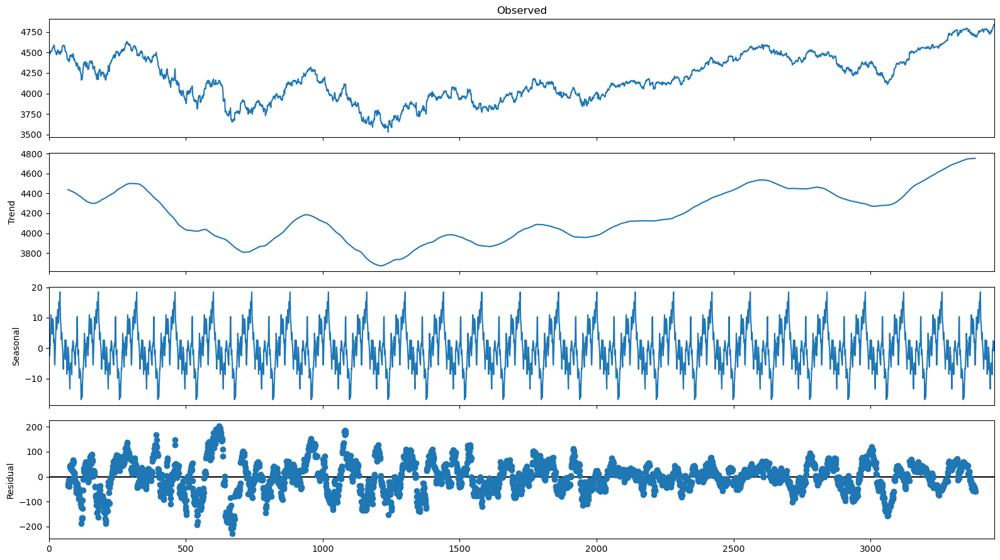

In [54]:
from statsmodels.tsa.seasonal import seasonal_decompose

result = seasonal_decompose(df.to_numpy(), model='additive', period=140)
# period 
# 7 hours in a day
# 35 hours in a week (mon-fri)
# 140 hours in a month (4 weeks)
# 1764 hours in a year (252 trading days)

fig = result.plot()
fig.set_size_inches((16, 9))
fig.tight_layout()
plt.show()

#### Imputed Time Series Seasonal Decomposition

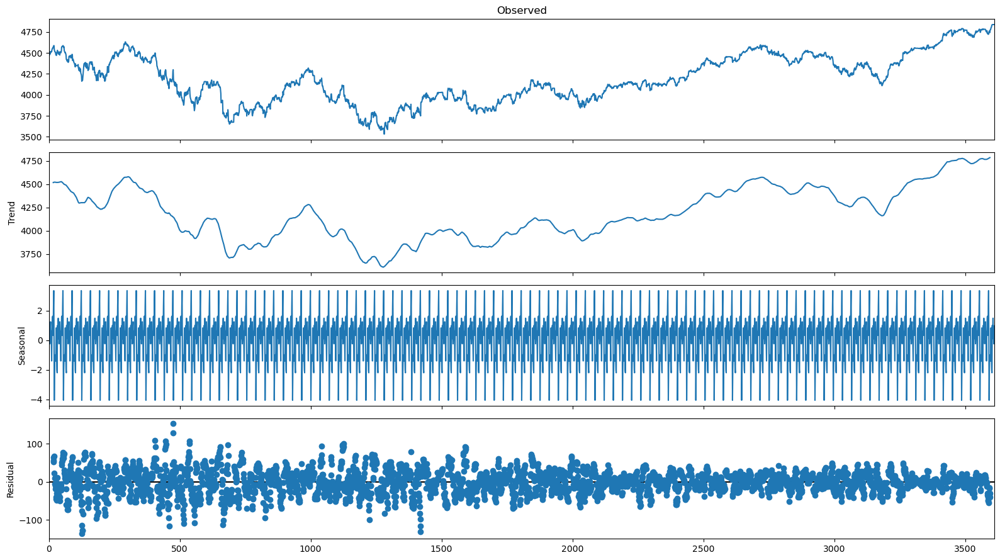

In [55]:
result = seasonal_decompose(imputed_df.to_numpy(), model='additive', period=35)

fig = result.plot()
fig.set_size_inches((16, 9))
fig.tight_layout()
plt.show()

#### Non-Imputed Time Series STL Decomposition

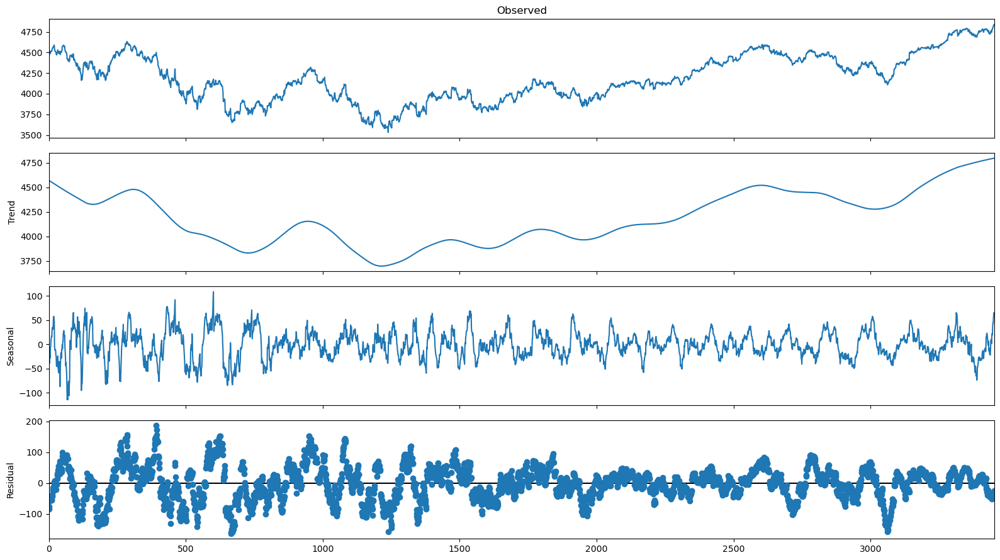

In [59]:
from statsmodels.tsa.seasonal import STL

result = STL(df.to_numpy().flatten(), period=140).fit()
fig = result.plot()
fig.set_size_inches((16, 9))
fig.tight_layout()
plt.show()

#### Imputed Time Series STL Decomposition

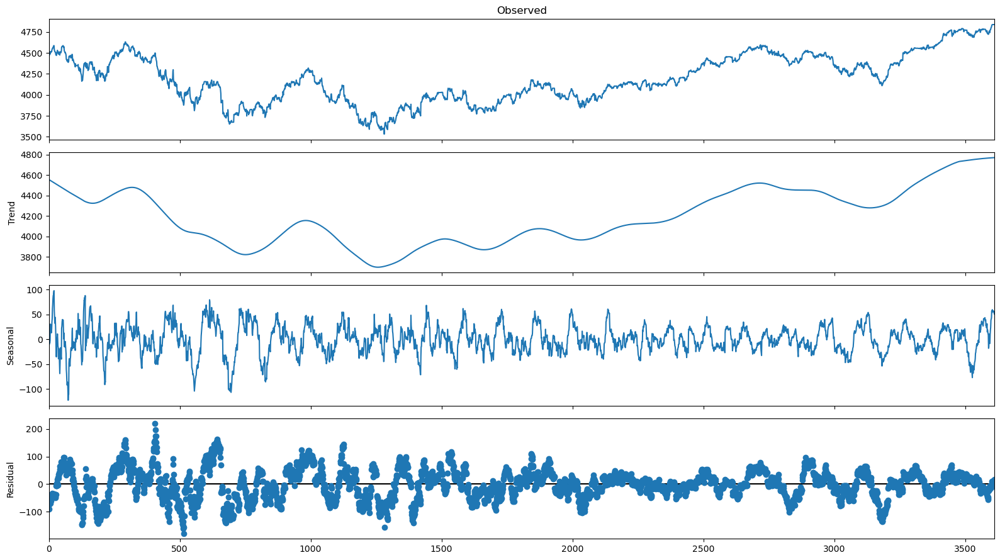

In [63]:
result = STL(imputed_df.to_numpy().flatten(), period=140).fit()
fig = result.plot()
fig.set_size_inches((16, 9))
fig.tight_layout()
plt.show()

#### Non-Imputed Time Series Multiple STL Decomposition

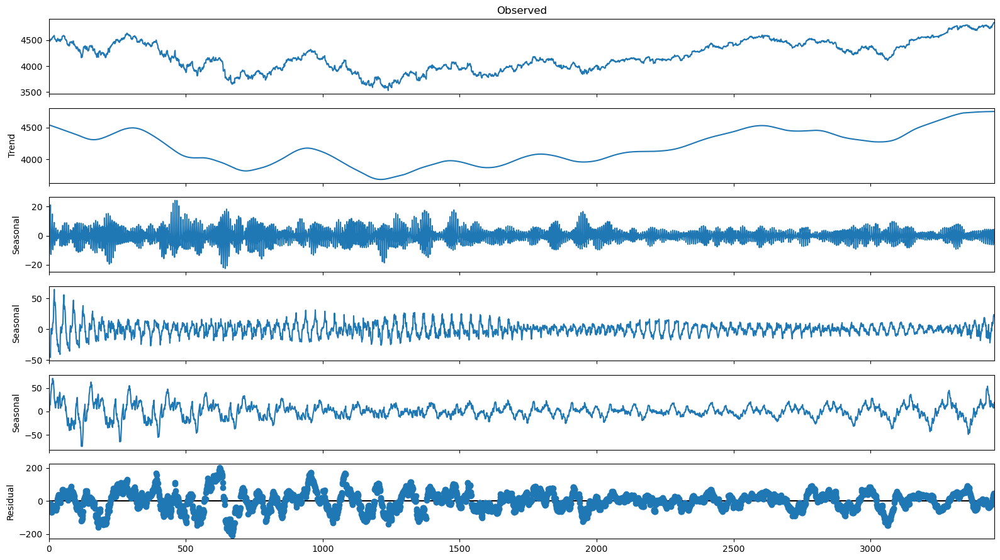

In [64]:
from statsmodels.tsa.seasonal import MSTL

result = MSTL(df.to_numpy(), periods=[7, 35, 140]).fit()
fig = result.plot()
fig.set_size_inches((16, 9))
fig.tight_layout()
plt.show()


#### Imputed Time Series Multiple STL Decomposition

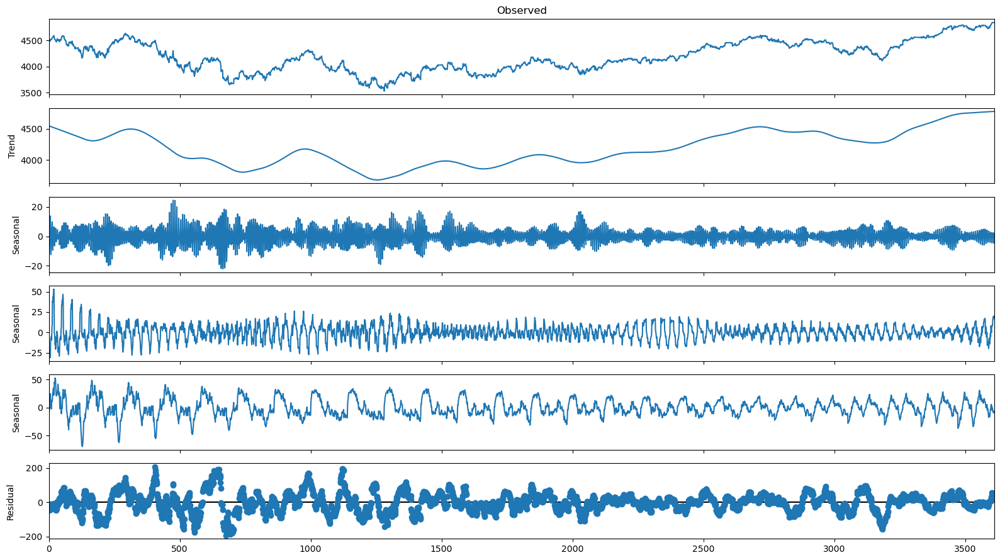

In [65]:
result = MSTL(imputed_df.to_numpy(), periods=[7, 35, 140]).fit()
fig = result.plot()
fig.set_size_inches((16, 9))
fig.tight_layout()
plt.show()